# DNA/RNA Virus Toolklit

![title](https://www.sciencealert.com/images/2020-03/processed/virus_topic_1024.jpg)

## Import needed Python libraries

In [218]:
from tqdm import tqdm
import time
import json
import pandas as pd
import numpy as np
import random
from collections import Counter
import os, sys, traceback

from Bio import SeqIO
from Bio.Seq import Seq
from Bio.SeqUtils.ProtParam import ProteinAnalysis
from Bio.Alphabet import generic_dna

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import StandardScaler
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.decomposition import TruncatedSVD
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering

from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import confusion_matrix, roc_curve, auc, classification_report
from sklearn.feature_selection import RFE

import nltk
from nltk.util import ngrams
from nltk import word_tokenize

plt.style.use('ggplot')

## Structures needed in genome analysis

In [3]:
# declare valid nucleotides, proteins and their complements, as well as uncertain letters appearing in sequences from NCBI
nucleotides = ["A", "T", "C", "G"]
proteins = ['A','D','E','G','F','L','S','Y','C','W','L','P','H','Q','R','I','M','T','N','K','S','R','V']
complements = {"A": "T", "T": "A", "G": "C", "C": "G"}
uncertainties = ['W', 'U', 'S', 'M', 'K', 'R', 'Y', 'B', 'D', 'H', 'V', 'N', 'Z']
amino_acids = {
    'alanine': 'A', 'arginine': 'R', 'Asparagine': 'N', 'Aspartic Acid': 'D',
    'Cysteine': 'C', 'Glutamic Acid': 'E', 'Glutamine': 'Q',
    'Glycine': 'G', 'Histidine': 'H', 'Isoleucine': 'I', 'Leucine': 'L',
    'Lysine': 'K', 'Methionine': 'M', 'Phenylalanine': 'F', 'Proline': 'P',
    'Serine': 'S', 'Threonine': 'T', 'Tryptophan': 'W', 'Tyrosine': 'Y',
    'Valine': 'V'
}

# using mRNA in lookup, not tRNA anti-codon
start_codons = ["ATG"]
stop_codons = ["TAA", "TAG", "TGA"]
dna_codons = {
    # 'M' - START, '_' - STOP
    "GCT": "A", "GCC": "A", "GCA": "A", "GCG": "A",
    "TGT": "C", "TGC": "C",
    "GAT": "D", "GAC": "D",
    "GAA": "E", "GAG": "E",
    "TTT": "F", "TTC": "F",
    "GGT": "G", "GGC": "G", "GGA": "G", "GGG": "G",
    "CAT": "H", "CAC": "H",
    "ATA": "I", "ATT": "I", "ATC": "I",
    "AAA": "K", "AAG": "K",
    "TTA": "L", "TTG": "L", "CTT": "L", "CTC": "L", "CTA": "L", "CTG": "L",
    "ATG": "M",
    "AAT": "N", "AAC": "N",
    "CCT": "P", "CCC": "P", "CCA": "P", "CCG": "P",
    "CAA": "Q", "CAG": "Q",
    "CGT": "R", "CGC": "R", "CGA": "R", "CGG": "R", "AGA": "R", "AGG": "R",
    "TCT": "S", "TCC": "S", "TCA": "S", "TCG": "S", "AGT": "S", "AGC": "S",
    "ACT": "T", "ACC": "T", "ACA": "T", "ACG": "T",
    "GTT": "V", "GTC": "V", "GTA": "V", "GTG": "V",
    "TGG": "W",
    "TAT": "Y", "TAC": "Y",
    "TAA": "_", "TAG": "_", "TGA": "_"
}

rna_codons = {
    # 'M' - START, '_' - STOP
    "GCU": "A", "GCC": "A", "GCA": "A", "GCG": "A",
    "UGU": "C", "UGC": "C",
    "GAU": "D", "GAC": "D",
    "GAA": "E", "GAG": "E",
    "UUU": "F", "UUC": "F",
    "GGU": "G", "GGC": "G", "GGA": "G", "GGG": "G",
    "CAU": "H", "CAC": "H",
    "AUA": "I", "AUU": "I", "AUC": "I",
    "AAA": "K", "AAG": "K",
    "UUA": "L", "UUG": "L", "CUU": "L", "CUC": "L", "CUA": "L", "CUG": "L",
    "AUG": "M",
    "AAU": "N", "AAC": "N",
    "CCU": "P", "CCC": "P", "CCA": "P", "CCG": "P",
    "CAA": "Q", "CAG": "Q",
    "CGU": "R", "CGC": "R", "CGA": "R", "CGG": "R", "AGA": "R", "AGG": "R",
    "UCU": "S", "UCC": "S", "UCA": "S", "UCG": "S", "AGU": "S", "AGC": "S",
    "ACU": "T", "ACC": "T", "ACA": "T", "ACG": "T",
    "GUU": "V", "GUC": "V", "GUA": "V", "GUG": "V",
    "UGG": "W",
    "UAU": "Y", "UAC": "Y",
    "UAA": "_", "UAG": "_", "UGA": "_"
}

# two test sequences for the below methods, one is COVID, and the other is deformed wing disease (avian), virulent and non-virulent respectively
BT006808_1 = "ATGGCCCTGTGGATGCGCCTCCTGCCCCTGCTGGCGCTGCTGGCCCTCTGGGGACCTGACCCAGCCGCAGCCTTTGTGAACCAACACCTGTGCGGCTCACACCTGGTGGAAGCTCTCTACCTAGTGTGCGGGGAACGAGGCTTCTTCTACACACCCAAGACCCGCCGGGAGGCAGAGGACCTGCAGGTGGGGCAGGTGGAGCTGGGCGGGGGCCCTGGTGCAGGCAGCCTGCAGCCCTTGGCCCTGGAGGGGTCCCTGCAGAAGCGTGGCATTGTGGAACAATGCTGTACCAGCATCTGCTCCCTCTACCAGCTGGAGAACTACTGCAACTAG"
MT324680_1 = "CAAKACTCACTTTCTTCCACAGCAAGTGCACTTGGAAAACTTCAAGATGTGGTCAACCAAAATGCACAAGCTTTAAACACGCTTGTTAAACAACTTAGCTCCAATTTTGGTGCAATTTCAAGTGTTTTAAATGATATCCTTTCACGTCTTGACAAAGTTGAGGCTGAAGTGCAAATTGATAGGTTGATCACAGGCAGACTTCAAAGTTTGCAGACATATGTGACTCAACAATTAATTAGAGCTGCAGAAATCAGAGCTTCTGCTAATCTTGCTGCTACTAAAATGTCAGAGTGTGTACTTGGACAATCAAAAAGAGTTGATTTTTGTGGAAAGGGCTATCATCTTATGTCCTTCCCTCAGTCAGCACCTCATGGTGTAGTCTTCTTGCATGTGACTTATGTCCCTGCACAAGAAAAGAACTTCACAACTGCTCCTGCCATTTGTCATGATGGAAAAGCACACTTTCCTCGTGAAGGTGTCTTTGTTTCAAA"

## Defined bioinformatic functions

In [4]:
def translateNucleotides(seq):
    """
    input: string sequence from fasta file or string input
    operation: translates nucleotide sequence into protein sequence, and removes unknown characters
    output: returns a clean translated protein sequence
    """
    
    seq = Seq(seq, generic_dna)
    translated_seq = str(seq.translate()).replace('*', '')
    clean_seq = ''.join([p for p in translated_seq if p in proteins])
    return clean_seq

In [12]:
def getVirusDf(fasta_data):
    """
    input: fasta data file uploaded by user
    operation: after sequence translation, uses protein analysis \
       and other custom functions to calcuate metrics used in virology research \
    output: returns a dataframe with a feature/column for each engineered feature
    
    """
    
    try:
        ids = [] # accession id, searchable on NCBI
        descs = [] # text description of strain
        aa_percs = [] # ratio of amino acids in strain
        m_weights = [] # molecular weight
        a = [] # aromaticity
        ii = [] # instability index, > 40 means unstable / short half life .instability_index()
        n_seqs = [] # nuleotide sequence
        p_seqs = [] # translated protein sequence

        for record in tqdm(fasta_data):
            print(f'Processing {record.id} - {record.description}')
#             str_seq = cleanPlaceholderNucleotides(str(record.seq))
            str_seq = str(record.seq)
    
            # translated nucleotide string sequence
            p_seq = translateNucleotides(str_seq)
            ids.append(record.id)
            descs.append(record.description)
            
            # GC content
            gc_content = calcGcContent(str_seq)
            
            # protein analysis methods
            analysis = ProteinAnalysis(p_seq)
            aa_percs.append(analysis.get_amino_acids_percent())
            m_weights.append(analysis.molecular_weight())
            ii.append(analysis.instability_index())
            a.append(analysis.aromaticity())
            
            # nucleotide and protein string sequences
            n_seqs.append(str_seq)
            p_seqs.append(str(record.seq.translate()).replace('*', ' '))

        virus_df = pd.DataFrame({
            "ids": ids,
            "description": descs,
            "gc_content": gc_content,
            "amino_acid_percents": aa_percs,
            "molecular_weights": m_weights,
            "aromaticity": a,
            "instability_index": ii,
            "nucleotide_sequence": n_seqs,
            "protein_sequence": p_seqs
        })

        return virus_df
                  
    except Exception as e:
        print('-'*80)
        print(f"Exception in building virus datatframe: {e}")
        traceback.print_exc(file=sys.stdout)
        print('-'*80)

In [13]:
# test function for taking nucleotide string sequence and translating it to protein sequence
def proteinTranslation(x):
    return str(Seq(x).translate()).replace('*', ' ')

In [14]:
# manually defined function to return all of the protein analysis components
def proteinAnalysis(s):
    aa_percent, molecular_weight, instability_index, aromaticity = [], [], [], []
    for x in tqdm(s):
        protein_analysis = ProteinAnalysis(x.replace(' ', ''))
        aa_percent.append(protein_analysis.get_amino_acids_percent())
        molecular_weight.append(protein_analysis.molecular_weight())
        instability_index.append(protein_analysis.instability_index())
        aromaticity.append(protein_analysis.aromaticity())
    return aa_percent, molecular_weight, instability_index, aromaticity

In [15]:
# removes sequences with string length outside of 1.5IQR range
def filterOutliers(df):
    q1 = df.seq_len.quantile(.25)
    q3 = df.seq_len.quantile(.75)
    iqr = q3 - q1
    
    lower_bound = q1 - iqr * 1.5
    upper_bound = q3 + iqr * 1.5
    
    print(f'Lower IQR bound: {lower_bound}, Upper IQR bound: {upper_bound}')
    
    return df[(df.seq_len<=upper_bound) & (df.seq_len>=lower_bound)].copy()

In [16]:
# used to remove a string buffer for invalid sequences
def removeStringBuffer(seq, i):
    out_seq = seq[:i-i%3] + seq[i+3-i%3:]
    return out_seq.replace('\n', '')

In [17]:
# used to clean placeholder characters from nucleotide sequence, later not used because only passing valid sequences
def cleanPlaceholderNucleotides(seq):
    k_pos = []
    for i in range(len(seq)):
        if seq[i] not in nucleotides:
            print(f'Found placeholder at {i}th nucleotide')
            k_pos.append(i)
    
    k_seq = seq
    if len(k_pos) > 0:
        for pos in k_pos:
            k_seq = removeStringBuffer(k_seq, pos)

    return k_seq[:(len(k_seq)-len(k_seq)%3)]

In [18]:
# returns a list of amino acid triples
def buildAminoTriples(s):
    seq_list = []
    for i in range(0, len(s), 3):
        seq_list.append(s[i:i+3])
    return seq_list

In [19]:
# returns a dictionary with count of all nucleotides in string sequence
def countNucleotides(seq):
#     a_num = seq.count('A')
#     t_num = seq.count('T')
#     c_num = seq.count('C')
#     g_num = seq.count('G')
#     gc_content = (c_num + g_num) / (c_num + g_num + a_num + c_num)
#     nuc_dict = {"A": a_num,
#                "T": t_num,
#                "C": c_num,
#                "G": g_num,
#                "GC": gc_content}
    nuc_dict = dict(Counter(seq))
    return nuc_dict

In [20]:
# validates if a sequence contains only valid DNA nucleotides (A, C, T, G)
def validateString(seq):
    tmp_seq = seq.upper()
    for nuc in tmp_seq:
        if nuc not in nucleotides:
            return False
    return True

In [21]:
# generates a random sequence of DNA nucleotides
def generateRandomString(num_nucs):
    rand_seq = ''.join([random.choice(nucleotides) for nuc in range(num_nucs)])
    return rand_seq

In [22]:
# transcribes a nucleotide sequence from DNA to RNA (aka swapping T for U)
def transcription(seq):
    return seq.replace("T", "U")

In [23]:
# returns the reverse complement of the nucleotide sequence
def reverseComplement(seq):
    return ''.join([complements[nuc] for nuc in seq])[::-1]

In [24]:
# calculates the GC content of the nucleotide sequence
def calcGcContent(seq):
    return round((seq.count("C") + seq.count("G")) / len(seq) * 100, 3)

In [25]:
# calculates the GC content of a subsequence, default range 20
def subseqGcContent(seq, k=20):
    res = []
    for i in range(0, len(seq) - k + 1, k):
        subseq = seq[i:i + k]
        res.append(calcGcContent(subseq))
    return res

In [26]:
# translates DNA or RNA nucleotide sequence to proteins by looking up codon dictionary values above
def translateSequence(seq, seq_type='dna', init_pos=0):
    if seq_type == 'dna':
        return [dna_codons[seq[pos:pos+3]] for pos in range(init_pos, len(seq) -2, 3)]
    elif seq_type == 'rna':
        return [rna_condons[seq[pos:pos+3]] for pos in range(init_pos, len(seq) -2, 3)]
    else:
        return ['invalid genome type provided']

In [27]:
# identifies the frequency of codons in an amino acid string
def codonUsage(seq, aminoacid):
    codon_list = []
    for i in range(0, len(seq) - 2, 3):
        if dna_codons[seq[i:i + 3]] == aminoacid:
            codon_list.append(seq[i:i + 3])
            
    codon_frequencies = dict(Counter(codon_list))
    total_weight = sum(codon_frequencies.values())
    for seq in codon_frequencies:
        codon_frequencies[seq] = round(codon_frequencies[seq] / total_weight, 2)
    return codon_frequencies

In [28]:
# creates reading frames from protein sequence
def generateReadingFrames(seq):
    frames = []
    frames.append(translateSequence(seq, 'dna', 0))
    frames.append(translateSequence(seq, 'dna', 1))
    frames.append(translateSequence(seq, 'dna', 2))
    frames.append(translateSequence(reverseComplement(seq), 'dna', 0))
    frames.append(translateSequence(reverseComplement(seq), 'dna', 1))
    frames.append(translateSequence(reverseComplement(seq), 'dna', 2))
    return frames

In [29]:
# extracts protein sequence from the amino acid string, uses codon triplets
def proteinsFromReadingFrame(amino_acids):
    current_protein = []
    proteins = []
    
    for amino_acid in amino_acids:
        if amino_acid == "_":
            if current_protein:
                for protein in current_protein:
                    proteins.append(protein)
                current_protein = []
        else:
            if amino_acid == "M":
                current_protein.append("")
            for i in range(len(current_protein)):
                current_protein[i] += amino_acid
    return proteins

In [30]:
# aggregates proteins from reading frames into a complete protein sequence
def aggregateProteinsFromReadingFrames(seq, start_pos=0, end_pos=0, ordered=False):
    if end_pos > start_pos:
        reading_frames = generateReadingFrames(seq[start_pos: end_pos])
    else:
        reading_frames = generateReadingFrames(seq)
    
    result = []
    for frame in reading_frames:
        proteins = proteinsFromReadingFrame(frame)
        for protein in proteins:
            result.append(protein)
            
    if ordered:
        return sorted(result, key=len, reverse=True)
    return result

## Import CSV files of valid sequences

After running the sequence_splitter.ipynb, two output CSV files were created.  Starting with the cell below, these two files of valid and complete virus DNA sequences will be imported into this environment to run analysis.  The source data for this analysis was obtained by downloading nucleotide sequences in FASTA file format from the National Institute of Health's NCBI Virus database.  For example, here is a link that shows where data for the complete COVID genome sequences were obtained:

https://www.ncbi.nlm.nih.gov/labs/virus/vssi/#/virus?SeqType_s=Nucleotide&VirusLineage_ss=Severe%20acute%20respiratory%20syndrome%20coronavirus%202,%20taxid:2697049&SourceDB_s=GenBank&Completeness_s=complete

In [31]:
t1 = time.time()
non_vir_df = pd.read_csv('valid_non_virulent_sequences.csv') # archive of valid (only ATCG) non-virulent sequences
vir_df = pd.read_csv('valid_virulent_sequences.csv') # archive of valid (only ATCG) non-virulent sequences

print(f'Took {time.time() - t1} seconds to upload data files')

Took 3.431185722351074 seconds to upload data files


In [32]:
# give virulent df a categorical class, change to category type and add column for sequence length
vir_df['class'] = 'virulent'
vir_df['class'] = vir_df['class'].astype('category')
vir_df['seq_len'] = vir_df['seq_str'].apply(lambda x: len(x))

# give non-virulent df a categorical class, change to category type and add column for sequence length
non_vir_df['class'] = 'non-virulent'
non_vir_df['class'] = non_vir_df['class'].astype('category')
non_vir_df['seq_len'] = non_vir_df['seq_str'].apply(lambda x: len(x))

Inspecting the imported files, we can see there is a roughly 3:1 split between virulent and non-virulent genomes.

In [33]:
non_vir_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11442 entries, 0 to 11441
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   seq_id    11442 non-null  object  
 1   seq_name  11442 non-null  object  
 2   seq_desc  11442 non-null  object  
 3   seq_str   11442 non-null  object  
 4   class     11442 non-null  category
 5   seq_len   11442 non-null  int64   
dtypes: category(1), int64(1), object(4)
memory usage: 458.3+ KB


In [34]:
vir_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32893 entries, 0 to 32892
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   seq_id    32893 non-null  object  
 1   seq_name  32893 non-null  object  
 2   seq_desc  32893 non-null  object  
 3   seq_str   32893 non-null  object  
 4   class     32893 non-null  category
 5   seq_len   32893 non-null  int64   
dtypes: category(1), int64(1), object(4)
memory usage: 1.3+ MB


## View distribution of length of DNA/RNA sequences

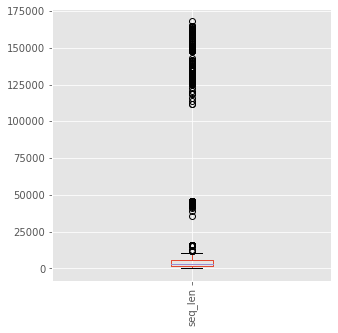

In [35]:
non_vir_df.seq_len.plot(kind='box', rot=90, figsize=(5,5))

In [52]:
non_vir_df[non_vir_df['seq_len']>=100000]['seq_name'].value_counts()

MH261376.1    1
MK388110.1    1
KY979487.1    1
MK388105.1    1
KY548806.1    1
             ..
JQ991010.1    1
KM386655.1    1
HG425345.1    1
MK388106.1    1
KF644572.1    1
Name: seq_name, Length: 328, dtype: int64

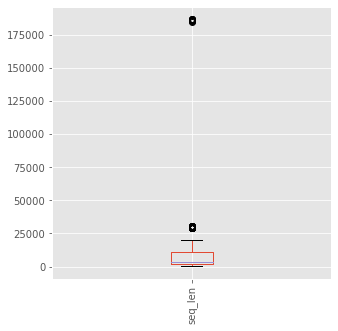

In [38]:
vir_df.seq_len.plot(kind='box', rot=90, figsize=(5,5))

In [50]:
vir_df[vir_df['seq_len']>=175000]['seq_name'].value_counts()

DQ437580.1    1
DQ437581.1    1
DQ437587.1    1
DQ437592.1    1
DQ437591.1    1
DQ437585.1    1
DQ437584.1    1
DQ437588.1    1
DQ437586.1    1
DQ437590.1    1
DQ437583.1    1
DQ437582.1    1
Name: seq_name, dtype: int64

From observing the box plots for the two classes of viruses, there are clearly outliers present in the data.  For virulent sequences, we will be later filtering around DNA sequence length of 50,000 nucleotides, and same for non-virulent.

## Sample and concatenate two dataframes

In order to validate the outliers found above, we will take a sample from each dataframe, and then merge/concat the two objects into a single one to show the box plot again and test if the outliers are still the same.  We found out that there is still a thredshold around 25,000 and around 50,000.  For the virulent strains, those above 175,000 are Small Pox, while uncertain which species of virus for the non-virulent becuase there are over 300 of animal or plant viruses.

In [39]:
vir_df_sample = vir_df.sample(n=10000, weights='seq_len', random_state=42)
non_vir_df_sample = non_vir_df.sample(n=10000, weights='seq_len', random_state=42)

In [40]:
sample_df = pd.concat([vir_df_sample, non_vir_df_sample])
sample_df.reset_index(drop=True, inplace=True)

In [41]:
sample_df.head()

,seq_id,seq_name,seq_desc,seq_str,class,seq_len
0,KT749832.1,KT749832.1,KT749832.1 |Hepatitis B virus isolate FL10| co...,TTCCACTGCCTTCCACCAAGCTCTGCAGGATCCCAGAGTCAGGGGT...,virulent,3221
1,EF027134.1,EF027134.1,EF027134.1 |Chikungunya virus strain IND-06-AP...,GTAGCCTACCAGTTTCTTACTGCTCTACTCTGCAAAGCAAGAGATT...,virulent,11779
2,HQ332177.1,HQ332177.1,HQ332177.1 |Dengue virus 1 strain VE_61059_200...,AGTTGTTAGTCTACGTGGACCGACAAGAACAGTTTCGAATCGGAAG...,virulent,10735
3,KM677246.1,KM677246.1,KM677246.1 |Japanese encephalitis virus isolat...,AGAAGTTTATCTGTGTGAACTTCTTGACTTAGTATCGTTGAGAGGA...,virulent,10988
4,MT451602.1,MT451602.1,MT451602.1 |Severe acute respiratory syndrome ...,ACTTTCGATCTCTTGTAGATCTGTTCTCTAAACGAACTTTAAAATC...,virulent,29818


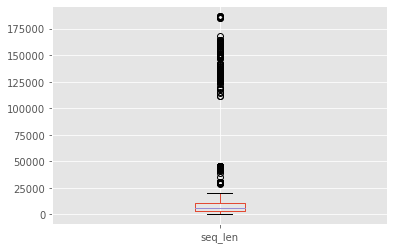

In [42]:
sample_df.seq_len.plot(kind='box')

In [43]:
merged_df = pd.concat([vir_df, non_vir_df])

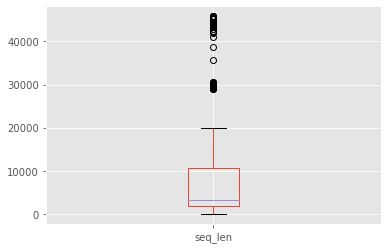

In [44]:
# filtered_df = filterOutliers(merged_df)
filtered_df = merged_df[merged_df.seq_len<=50000]
filtered_df.reset_index(drop=True, inplace=True)
filtered_df.seq_len.plot(kind='box')

## Reconstruct common protein analysis

These next few cells are the first iteration on how we performed the protein analysis.  They take a few minutes to run each because there are over 40,000 sequences, of length in the hundreds to 50,000 nucleotides, so the conversion process is computationally intensive.

#### First, translate the DNA nucleotide sequences to proteins

In [53]:
t1 = time.time()
filtered_df['p_seq'] = filtered_df['seq_str'].apply(lambda x: proteinTranslation(x))
print(f'Took {time.time() - t1} seconds to translate nucleotides to proteins')

c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\Bio\Seq.py:2859: BiopythonWarning: Partial codon, len(sequence) not a multiple of three. Explicitly trim the sequence or add trailing N before translation. This may become an error in future.
  BiopythonWarning,


Took 53.25126504898071 seconds to translate nucleotides to proteins


c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


#### Calculates the GC content from DNA sequence of nucleotides

In [54]:
filtered_df['gc_content'] = filtered_df['seq_str'].apply(lambda x: calcGcContent(x))

c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


#### Renaming the sequence columns to be more user friendly

In [55]:
filtered_df.rename(columns={'p_seq': 'protein_sequence', 'seq_str': 'nucleotide_sequence'}, inplace=True)

c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\pandas\core\frame.py:4133: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


#### For each sequence, run a protein analysis on the protein sequence to obtain metrics/features

In [56]:
aa, mw, a, ii = np.apply_along_axis(proteinAnalysis, 0, filtered_df['protein_sequence'].values)
new_cols = ['amino_acid_percents','molecular_weights','aromaticity','instability_index']
filtered_df[new_cols] = pd.DataFrame({'amino_acid_percents': aa, 
                                      'molecular_weights': mw, 
                                      'aromaticity': a, 
                                      'instability_index': ii})

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43995/43995 [02:54<00:00, 252.02it/s]
c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\pandas\core\frame.py:2963: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


In [57]:
filtered_df.head()

,seq_id,seq_name,seq_desc,nucleotide_sequence,class,seq_len,protein_sequence,gc_content,amino_acid_percents,molecular_weights,aromaticity,instability_index
0,MT577359.1,MT577359.1,MT577359.1 |Severe acute respiratory syndrome ...,CAACCAACTTTCGATCTCTTGTAGATCTGTTCTCTAAACGAACTTT...,virulent,29816,QPTFDLL ICSLNEL NLCGCHSAACLVHSRSIINN LLSLTGHE ...,38.006,"{'A': 0.0552571782689527, 'C': 0.0309853336087...",1.09139e+06,38.4863,0.0991531
1,MT582456.1,MT582456.1,MT582456.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,virulent,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.020,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.06503e+06,43.9497,0.148302
2,MT582458.1,MT582458.1,MT582458.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,virulent,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.006,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.06508e+06,43.9203,0.148411
3,MT582459.1,MT582459.1,MT582459.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,virulent,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.006,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.06512e+06,43.9611,0.148411
4,MT582460.1,MT582460.1,MT582460.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,virulent,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.006,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.06508e+06,43.9203,0.148411


#### Clean the sequence ID column as they contain suffixes which won't be able to join metadata files

In [58]:
filtered_df['seq_id'] = filtered_df['seq_id'].apply(lambda x: x.replace('.1', '').replace('.2', '').replace('.3', '').replace('.4', '').replace('.5', ''))

c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


#### Convert numeric columns to float data type

In [59]:
num_cols = ['molecular_weights', 'aromaticity', 'instability_index']
filtered_df[num_cols] = filtered_df[num_cols].astype('float')

c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\pandas\core\frame.py:2963: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


In [60]:
filtered_df.describe()

,seq_len,gc_content,molecular_weights,aromaticity,instability_index
count,43995.000000,43995.000000,4.399500e+04,43995.000000,43995.000000
mean,6578.015797,44.970452,2.383864e+05,46.709825,0.094844
std,7718.174561,4.948916,2.778305e+05,8.210236,0.021981
min,20.000000,20.000000,5.707251e+02,-22.060000,0.000000
25%,1767.000000,41.704500,6.322091e+04,41.909057,0.079845
50%,3215.000000,45.491000,1.169483e+05,46.701320,0.092473
75%,10595.500000,48.613000,3.807375e+05,51.751067,0.106424
max,45781.000000,70.000000,1.649370e+06,117.800000,0.333333


In [61]:
filtered_df.set_index('seq_id', inplace=True)

### Import metadata for pathogenic and nonpathogenic sequences

In addition to using the raw sequence data, we thought there might be something useful in the metadata of the tables in the NCBI Virus database.  So here we import the two files of same sequences (virulent and non-virulent) and then join the sequence data to the metadata on the index, which is also called the Accession ID.  Since the suffix to sequence ID was removed, the join will now be successful.

In [64]:
vir_meta_df = pd.read_csv('pathogenic_sequences_table.csv')
non_vir_meta_df = pd.read_csv('non_pathogenic_sequences_table.csv')

In [65]:
vir_meta_df.set_index('Accession', inplace=True)
vir_meta_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 37465 entries, MT565495 to S50225
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   Release_Date      37465 non-null  object
 1   Species           37465 non-null  object
 2   Genus             37445 non-null  object
 3   Family            37465 non-null  object
 4   Length            37465 non-null  int64 
 5   Nuc_Completeness  37465 non-null  object
 6   Geo_Location      35640 non-null  object
 7   Host              33229 non-null  object
 8   Isolation_Source  15258 non-null  object
 9   Collection_Date   33038 non-null  object
dtypes: int64(1), object(9)
memory usage: 3.1+ MB


In [66]:
non_vir_meta_df.set_index('Accession', inplace=True)
non_vir_meta_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11847 entries, MN734250 to M90541
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   Release_Date      11847 non-null  object
 1   Species           11847 non-null  object
 2   Genus             9334 non-null   object
 3   Family            11847 non-null  object
 4   Length            11847 non-null  int64 
 5   Nuc_Completeness  11847 non-null  object
 6   Geo_Location      10676 non-null  object
 7   Host              8162 non-null   object
 8   Isolation_Source  2751 non-null   object
 9   Collection_Date   9498 non-null   object
dtypes: int64(1), object(9)
memory usage: 1018.1+ KB


In [67]:
meta_df = pd.concat([vir_meta_df, non_vir_meta_df])

In [68]:
filtered_df = filtered_df.merge(meta_df, how='left', left_index=True, right_index=True)

In [70]:
filtered_df.head()

,seq_name,seq_desc,nucleotide_sequence,class,seq_len,protein_sequence,gc_content,amino_acid_percents,molecular_weights,aromaticity,...,Release_Date,Species,Genus,Family,Length,Nuc_Completeness,Geo_Location,Host,Isolation_Source,Collection_Date
seq_id,,,,,,,,,,,,,,,,,,,,,
MT577359,MT577359.1,MT577359.1 |Severe acute respiratory syndrome ...,CAACCAACTTTCGATCTCTTGTAGATCTGTTCTCTAAACGAACTTT...,virulent,29816,QPTFDLL ICSLNEL NLCGCHSAACLVHSRSIINN LLSLTGHE ...,38.006,"{'A': 0.0552571782689527, 'C': 0.0309853336087...",1.091393e+06,38.486263,...,2020-06-09T00:00:00Z,Severe acute respiratory syndrome-related coro...,Betacoronavirus,Coronaviridae,29816,complete,Bangladesh,Homo sapiens,NaN,4/25/2020
MT582456,MT582456.1,MT582456.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,virulent,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.020,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065028e+06,43.949719,...,2020-06-09T00:00:00Z,Severe acute respiratory syndrome-related coro...,Betacoronavirus,Coronaviridae,29782,complete,Germany: Dusseldorf,Homo sapiens,NaN,3/19/2020
MT582458,MT582458.1,MT582458.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,virulent,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.006,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065083e+06,43.920277,...,2020-06-09T00:00:00Z,Severe acute respiratory syndrome-related coro...,Betacoronavirus,Coronaviridae,29782,complete,Germany: Dusseldorf,Homo sapiens,NaN,3/18/2020
MT582459,MT582459.1,MT582459.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,virulent,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.006,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065118e+06,43.961120,...,2020-06-09T00:00:00Z,Severe acute respiratory syndrome-related coro...,Betacoronavirus,Coronaviridae,29782,complete,Germany: Dusseldorf,Homo sapiens,NaN,3/18/2020
MT582460,MT582460.1,MT582460.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,virulent,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.006,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065083e+06,43.920277,...,2020-06-09T00:00:00Z,Severe acute respiratory syndrome-related coro...,Betacoronavirus,Coronaviridae,29782,complete,Germany: Dusseldorf,Homo sapiens,NaN,3/17/2020


### Save point #1

#### Saving the state of this dataframe in CSV so that we can resume the analysis below without performing the above tasks over again, since they were somewhat computationally intensive to translate to proteins and run protein analysis on 40,000 sequences.

In [69]:
filtered_df.to_csv('virus_analysis.csv')

### Inspect feature distributions

Here is a save point where we can resume analysis in the notebook withouth having to repeat the protein translation and analysis steps.  This will just import the saved state as a new dataframe object. 

In [71]:
analysis_df = pd.read_csv('virus_analysis.csv')

In [72]:
analysis_df.isnull().sum()

seq_id                     0
seq_name                   0
seq_desc                   0
nucleotide_sequence        0
class                      0
seq_len                    0
protein_sequence           0
gc_content                 0
amino_acid_percents        0
molecular_weights          0
aromaticity                0
instability_index          0
Release_Date               0
Species                    0
Genus                   2509
Family                     0
Length                     0
Nuc_Completeness           0
Geo_Location            2736
Host                    7294
Isolation_Source       27419
Collection_Date         6100
dtype: int64

In [73]:
analysis_df.drop('Isolation_Source', axis=1, inplace=True)

#### Here is a list of all the unique virus names found in the metadata for sequences

In [74]:
virus_names = analysis_df.sort_values(by='Species').Species.unique().tolist()
virus_names

['Acute bee paralysis virus',
 'Aeonium ringspot virus',
 'African cassava mosaic virus',
 'Alces alces faeces associated microvirus MP10 5560',
 'Alces alces faeces associated microvirus MP11 5517',
 'Alces alces faeces associated microvirus MP12 5423',
 'Alces alces faeces associated microvirus MP15 5067',
 'Alces alces faeces associated microvirus MP18 4940',
 'Alces alces faeces associated microvirus MP21 4718',
 'Alces alces faeces associated microvirus MP3 6497',
 'Altai virus',
 'Amga orthohantavirus',
 'Amur virus',
 'Andean potato mottle virus',
 'Andes orthohantavirus',
 'Anelloviridae sp.',
 'Antarctic microvirus CAA_003_V_1',
 'Antarctic microvirus CAA_003_V_4',
 'Antarctic microvirus CAA_003_V_9',
 'Antarctic microvirus COCH21_V_SP_13',
 'Antarctic microvirus COCH21_V_SP_16',
 'Antarctic microvirus TYR_006_V_25',
 'Antarctic microvirus TYR_006_V_SP_13',
 'Aphid lethal paralysis virus',
 'Aphis gossypii virus',
 'Apis mellifera associated microvirus 1',
 'Apis mellifera ass

#### Making the species names to lower case text format

In [75]:
analysis_df['Species'] = analysis_df['Species'].apply(lambda x: x.lower())

#### Here is the count of viruses by family name under genus

In [76]:
virus_families = analysis_df.Family.unique().tolist()
analysis_df.Family.value_counts()

Orthomyxoviridae    10543
Flaviviridae         6779
Hepadnaviridae       6541
Coronaviridae        2997
Microviridae         2753
Circoviridae         2722
Reoviridae           1951
Geminiviridae        1455
Rhabdoviridae        1419
Paramyxoviridae      1370
Anelloviridae         947
Filoviridae           658
Hantaviridae          618
Togaviridae           543
Potyviridae           471
Secoviridae           449
Picornaviridae        323
Polyomaviridae        271
Tospoviridae          256
Bromoviridae          197
Parvoviridae          195
Dicistroviridae       120
Caulimoviridae        116
Adenoviridae          110
Birnaviridae           91
Retroviridae           37
Virgaviridae           34
Poxviridae             19
Baculoviridae           9
Herpesviridae           1
Name: Family, dtype: int64

#### Similarly, we can count the number of virulent vs. non-virulent in each family using crosstab

In [77]:
pd.crosstab(analysis_df['Family'], analysis_df['class']).sort_values(by='virulent', ascending=False)

class,non-virulent,virulent
Family,,
Orthomyxoviridae,0,10543
Flaviviridae,0,6779
Hepadnaviridae,0,6541
Coronaviridae,0,2997
Reoviridae,220,1731
Rhabdoviridae,0,1419
Paramyxoviridae,318,1052
Filoviridae,0,658
Hantaviridae,0,618


#### Defining a function to iteratively loop through each virus name specified to see the sequence length distributions

In [78]:
def plotSequenceLenHistogram(df, bins, strain):
    df[(df['Species'].str.contains(strain))]['seq_len'].hist(bins=bins)
    plt.title(f'{strain} Protein Length Distribution')
    plt.show()

In [79]:
virus_names = ['ebola', 'hanta', 'severe acute respiratory', 'influenza', 'rabies', 'dengue', 'hepatitis', 'hepacivirus', 'rota', 'chikungunya', 'west nile', 'zika', 'measles', 'middle east']

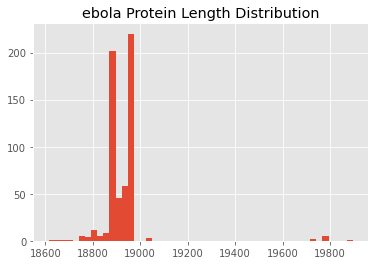

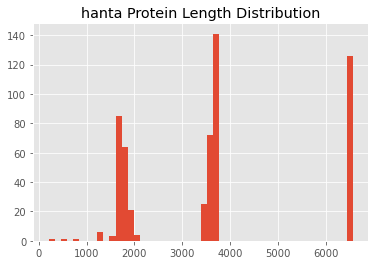

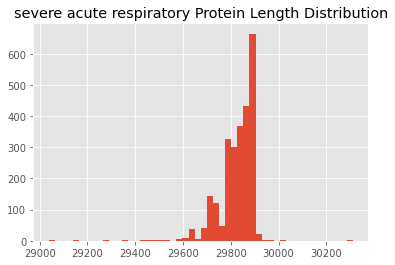

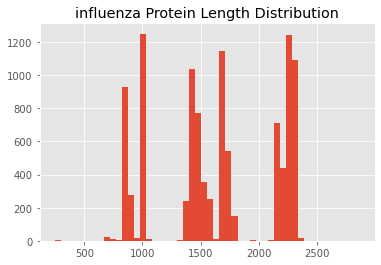

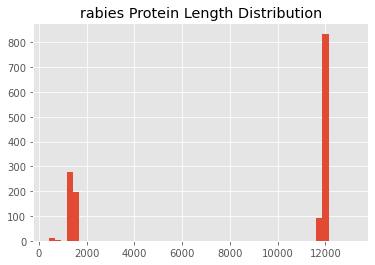

...

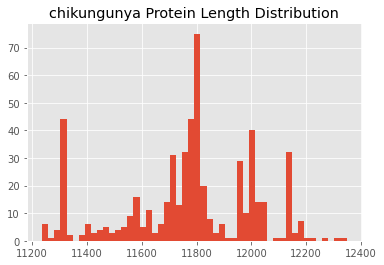

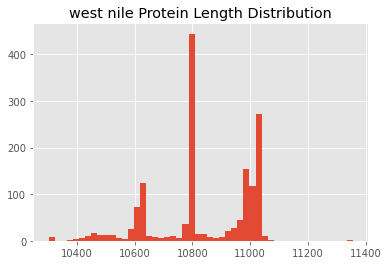

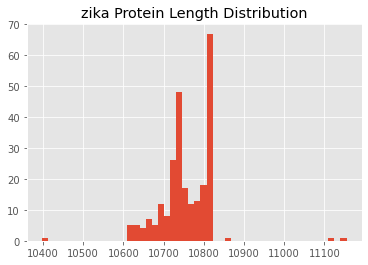

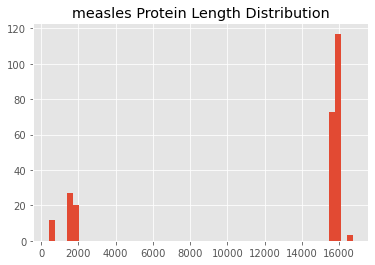

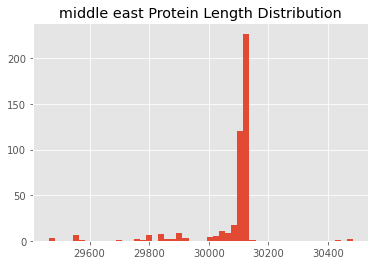

In [16]:
for name in virus_names:
    plotSequenceLenHistogram(analysis_df, 50, name)

#### Creating a pairplot in seaborn to see if there are any correlations between the protein analysis metrics

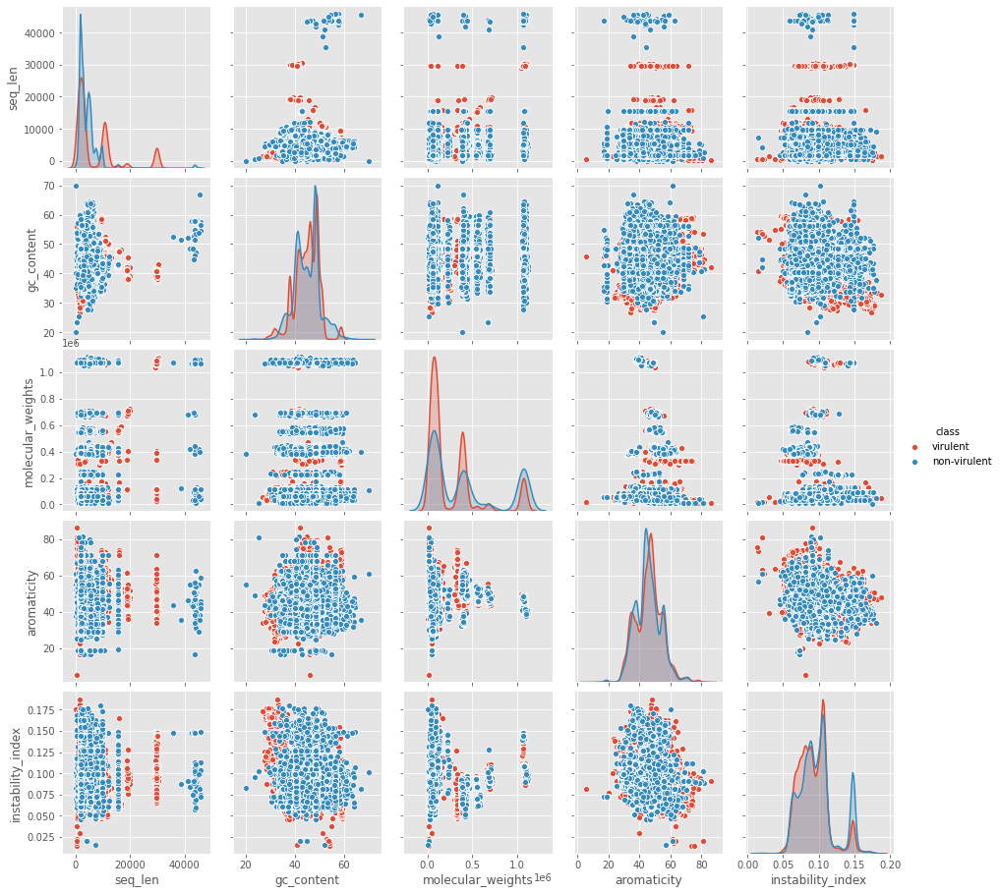

In [18]:
sns.pairplot(data=analysis_df[['seq_len', 'gc_content', 'molecular_weights', 'aromaticity', 'instability_index', 'class']], hue='class')
plt.show()

THere aren't any clear correlations amonths these feature pairs, although sequence length does appear to have a role in distinguishing the two classes for molecular weights, aromaticity and instability index.

#### Hisogram of sequence length for virulent virus species

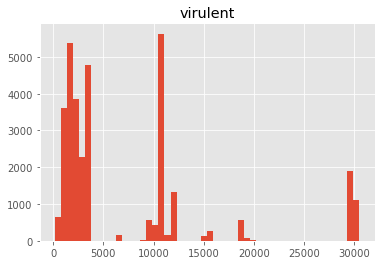

In [19]:
analysis_df[(analysis_df['class']=='virulent')].seq_len.hist(bins=50)
#  & (analysis_df['seq_desc'].str.contains('complete')) & (analysis_df['seq_len']>= 10000)
plt.title('virulent')
plt.show()

#### Hisogram of sequence length for non-virulent virus species

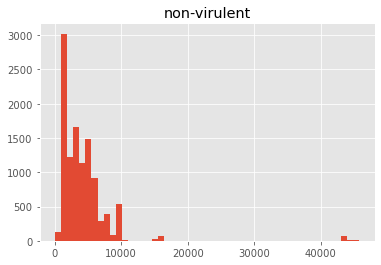

In [20]:
analysis_df[(analysis_df['class']=='non-virulent')].seq_len.hist(bins=50) 
#  & (analysis_df['seq_desc'].str.contains('complete')) & (analysis_df['seq_len'] <= 80000) & (analysis_df['seq_len']>= 10000)
plt.title('non-virulent')
plt.show()

As we can see in the two histograms above, it is lear that the sequence length for non-virulent strains has a near normal distribution between 0 to 10,000 length with some "outliers" above 40,000.  The virulent strains however are very multimodal, and more sparse, or not consistently clustered in the same length range.

This cell below can be ignored because it was used to filter strains to complete and to specific sequence length ranges based on class, but we figured this might inject some bias in the sample used to train models below.  The viruses should be complete based on the downloaded files, and the entire dataset has already removed outliers of length >= 50,000 nucleotides.

#### Showing where the virus sequences obtained from the database originate

In [94]:
analysis_df['Country'] = analysis_df['Geo_Location'].apply(lambda x: str(x).split(':')[0])
analysis_df['Country'] = analysis_df['Country'].replace(np.nan, 'Unknown')

In [106]:
country_counts = analysis_df['Country'].value_counts().reset_index()
country_counts.columns = ['Country', 'Virus_Count']

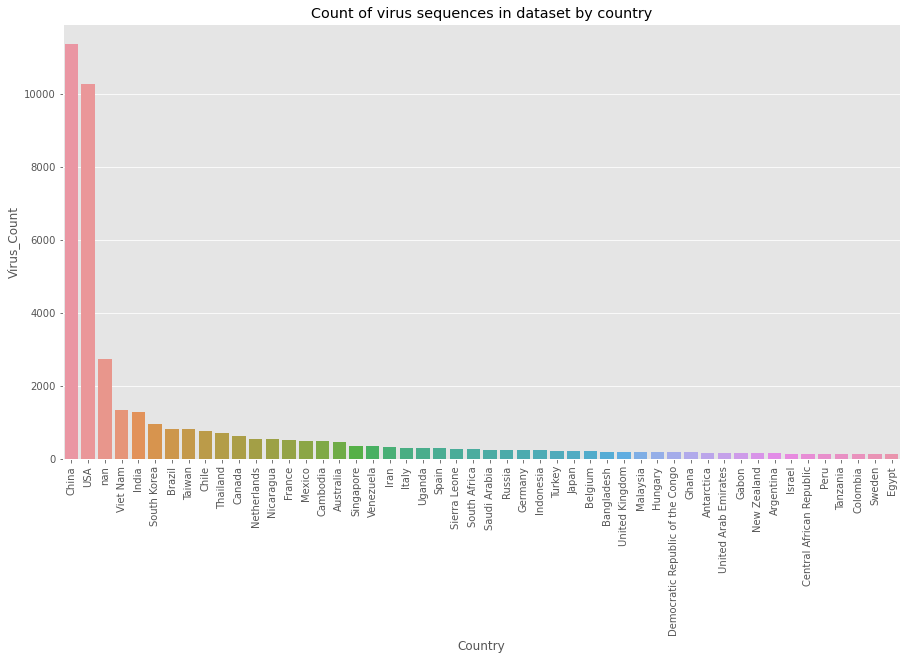

In [112]:
f, ax = plt.subplots(figsize=(15, 8))
sns.barplot(x='Country', y='Virus_Count', data=country_counts.head(50), ax=ax)
plt.title('Count of virus sequences in dataset by country')
plt.xticks(rotation=90)
plt.show()

In [21]:
# analysis_df = pd.concat([
#     filtered_df[(filtered_df['class']=='virulent') & (filtered_df['seq_desc'].str.contains('complete')) & (filtered_df['seq_len']>= 10000)],
#     filtered_df[(filtered_df['class']=='non-virulent') & (filtered_df['seq_desc'].str.contains('complete')) & (filtered_df['seq_len'] <= 80000) & (filtered_df['seq_len']>= 10000)]
# ])

#### Replacing single quote with double quotes in amino acid percents column so that json object can be loaded

In [81]:
analysis_df['amino_acid_percents'] = analysis_df['amino_acid_percents'].apply(lambda x: json.loads(x.replace("'", '"')))

#### Create a column name for each amino acid to be parsed from dictionary

In [82]:
aa_list = list(amino_acids.values())
aa_cols = ['amino_acid_' + aa for aa in aa_list]

#### Parse amino acid percent dictionary into a series, and perform lambda column renaming

In [83]:
amino_acids_percent_df = analysis_df['amino_acid_percents'].apply(pd.Series)
amino_acids_percent_df = amino_acids_percent_df.rename(columns = lambda x : 'amino_acid_' + str(x))

#### Correlation heatmap of amino acid consistency

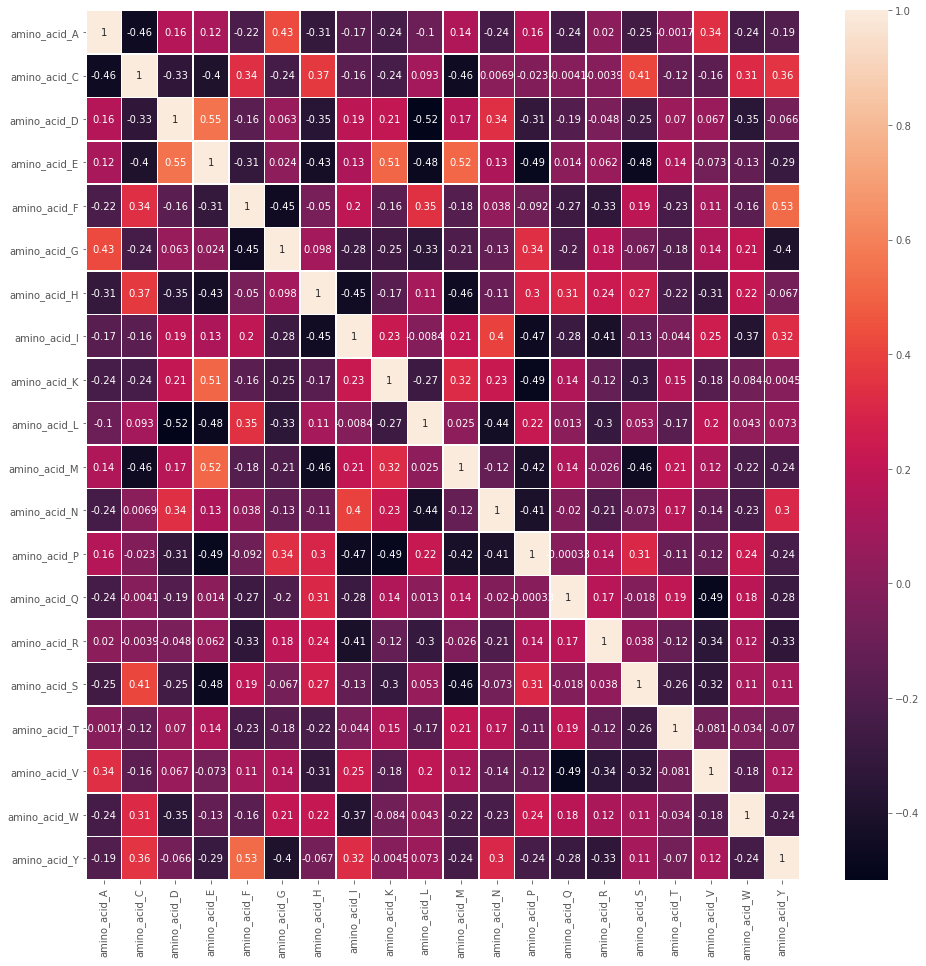

In [84]:
#Showing mutual information as heatmap with values
corr = amino_acids_percent_df.corr()
plt.figure(figsize = (16,16))
ax = sns.heatmap(corr,annot=True, linewidths=.5);

From this heatmap, we can see that multiple amino acid pairs have a high correlation.  For example, amino acid F and Y, as well as amino acids D with M and K, all have over .50 correlation R^2 value.  We're not subject matters on amino acids so not sure what this means.

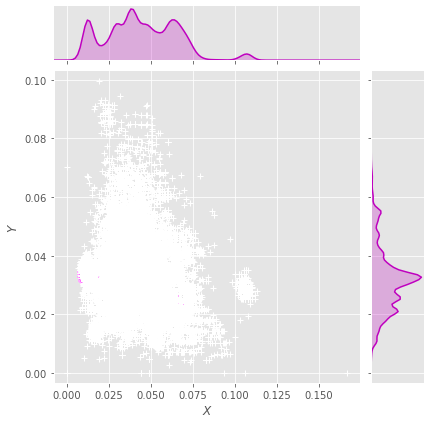

In [102]:
# script for plotting kde with scatter obtained from seaborn documentation
# https://seaborn.pydata.org/tutorial/distributions.html
g = sns.jointplot(x="amino_acid_E", y="amino_acid_Y", data=amino_acids_percent_df, kind="kde", color="m")
g.plot_joint(plt.scatter, c="w", s=30, linewidth=1, marker="+")
g.ax_joint.collections[0].set_alpha(0)
g.set_axis_labels("$X$", "$Y$");

Clearly there are too many dense overlapping data points for this to be meaningful.

#### KDE scattergram of comparing amino acid E and Y together, since this pair has .55 correlation

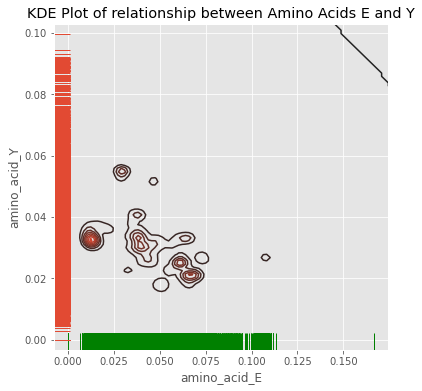

In [113]:
f, ax = plt.subplots(figsize=(6, 6))
sns.kdeplot(amino_acids_percent_df["amino_acid_E"], amino_acids_percent_df["amino_acid_Y"], ax=ax)
sns.rugplot(amino_acids_percent_df["amino_acid_E"], color="g", ax=ax)
sns.rugplot(amino_acids_percent_df["amino_acid_Y"], vertical=True, ax=ax)
plt.title('KDE Plot of relationship between Amino Acids E and Y');

The KDE plot helps to see the density and maybe some of the underlying correlation between these two features.

#### Merging/concatenating the analyais dataframe with the amino acids

In [85]:
analysis_df = pd.concat([analysis_df, amino_acids_percent_df], axis=1)

In [86]:
analysis_df.columns

Index(['seq_id', 'seq_name', 'seq_desc', 'nucleotide_sequence', 'class',
       'seq_len', 'protein_sequence', 'gc_content', 'amino_acid_percents',
       'molecular_weights', 'aromaticity', 'instability_index', 'Release_Date',
       'Species', 'Genus', 'Family', 'Length', 'Nuc_Completeness',
       'Geo_Location', 'Host', 'Collection_Date', 'amino_acid_A',
       'amino_acid_C', 'amino_acid_D', 'amino_acid_E', 'amino_acid_F',
       'amino_acid_G', 'amino_acid_H', 'amino_acid_I', 'amino_acid_K',
       'amino_acid_L', 'amino_acid_M', 'amino_acid_N', 'amino_acid_P',
       'amino_acid_Q', 'amino_acid_R', 'amino_acid_S', 'amino_acid_T',
       'amino_acid_V', 'amino_acid_W', 'amino_acid_Y'],
      dtype='object')

## Build TFIDF vectors to test for clustering in protein similarity 

We wanted to see if there was a way to cluster the viruses using the genome sequence data, and not the protein analysis metrics first.  This was an initial attempted at unsupervised learning with this dataset.  When you see a protein sequence, it literally looks like a long string of letters from the alphabet.  Each letter represents an amino acid, and a chain of amino acids in between start and stop codons (triplets of nucleotides) creates a protein, but when the proteins are separated with spaces, it kind of looks like a sentence of words.  This gave me the idea of vectorizing the proteins using the TFIDF algorithm, and then performing cluster and similarity analysis with the "syntax" of relevant protein subsequences.

In [87]:
protein_corpus = analysis_df.protein_sequence.values

#### Build the TFIDF vectorizer model and transform the corpus of proteins (array of protein sequences) into vectors.

In [88]:
t1 = time.time()

vectorizer = TfidfVectorizer(ngram_range=(1, 10), 
                             analyzer='word', norm='l2', 
                             max_features=5000, lowercase=False,
                             min_df=.01, max_df=.90)
protein_vectors = vectorizer.fit_transform(protein_corpus)

t2 = time.time()

print(f'Took {t2-t1:.3} seconds to build TFIDF vector')

Took 41.9 seconds to build TFIDF vector


In [89]:
protein_vectors.shape

(43995, 5000)

In [90]:
protein_vectors.toarray()[0:5]

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.01423777, 0.01423777,
        0.01424038],
       [0.01414843, 0.01415101, 0.01415359, ..., 0.01415617, 0.01415617,
        0.01415876],
       [0.01414843, 0.01415101, 0.01415359, ..., 0.01415617, 0.01415617,
        0.01415876],
       [0.01414843, 0.01415101, 0.01415359, ..., 0.01415617, 0.01415617,
        0.01415876]])

#### Here is the complete list of feature names, or protein subsequences from the vectorized corpus

In [114]:
vectorizer.get_feature_names()

['ACISLFVFVTFSCHCSLF',
 'ACISLFVFVTFSCHCSLF YGLYAC',
 'ACISLFVFVTFSCHCSLF YGLYAC LGDAYYDMVGYG',
 'ACISLFVFVTFSCHCSLF YGLYAC LGDAYYDMVGYG FVWF',
 'ACK',
 'ACK IFGFVC',
 'ACK IFGFVC LYHYWWS',
 'ACK IFGFVC LYHYWWS SLEFR',
 'AFS',
 'AFS QSC',
 'AFS QSC YNY',
 'AFS QSC YNY HSYTVFKPCLY',
 'AFS QSC YNY HSYTVFKPCLY LYALFLYFIATIVYFY',
 'AFS QSC YNY HSYTVFKPCLY LYALFLYFIATIVYFY KYKF',
 'AFS QSC YNY HSYTVFKPCLY LYALFLYFIATIVYFY KYKF SIYADYYSKEYC',
 'AFS QSC YNY HSYTVFKPCLY LYALFLYFIATIVYFY KYKF SIYADYYSKEYC ECR',
 'AFS QSC YNY HSYTVFKPCLY LYALFLYFIATIVYFY KYKF SIYADYYSKEYC ECR ILSRGFI',
 'AFS QSC YNY HSYTVFKPCLY LYALFLYFIATIVYFY KYKF SIYADYYSKEYC ECR ILSRGFI LFEVT',
 'AGCC',
 'AGCC SCS',
 'AGCC SCS KVEEVFECG',
 'AGCC SCS KVEEVFECG CSHAT',
 'AGCC SCS KVEEVFECG CSHAT VGKDG',
 'AGCC SCS KVEEVFECG CSHAT VGKDG SSYDPNV',
 'AGCC SCS KVEEVFECG CSHAT VGKDG SSYDPNV TG',
 'AGCC SCS KVEEVFECG CSHAT VGKDG SSYDPNV TG GQEGKSY',
 'AGCC SCS KVEEVFECG CSHAT VGKDG SSYDPNV TG GQEGKSY CYADNAFHYA',
 'AGCC SCS KVEEVFEC

#### Create a new dataframe object with selected columns and merge with TFIDF protein vectors

In [115]:
ids = analysis_df.reset_index().seq_id.values
classes = analysis_df['class'].values
species = analysis_df['Species'].values
family = analysis_df['Family'].values
country = analysis_df['Country'].values
amino_acids = analysis_df[aa_cols].values

In [116]:
num_cols = ['seq_len', 'gc_content', 'molecular_weights', 'aromaticity', 'instability_index']
numeric = analysis_df[num_cols].values

scaler = StandardScaler()
numeric_scaled = scaler.fit_transform(numeric)

In [117]:
vector_df = pd.DataFrame(protein_vectors.toarray())
vector_df['ids'] = ids
vector_df['class'] = classes
vector_df['species'] = species
vector_df['family'] = family
vector_df['country'] = country
vector_df[aa_cols] = pd.DataFrame(amino_acids)
vector_df[num_cols] = pd.DataFrame(numeric_scaled)
vector_df.set_index('ids', inplace=True)

In [118]:
vector_df.groupby(['class','family']).size()

class         family          
non-virulent  Adenoviridae          110
              Anelloviridae         947
              Baculoviridae           9
              Birnaviridae           91
              Bromoviridae          197
              Caulimoviridae        116
              Circoviridae         2722
              Dicistroviridae       120
              Geminiviridae        1455
              Herpesviridae           1
              Microviridae         2753
              Paramyxoviridae       318
              Parvoviridae          195
              Picornaviridae        323
              Polyomaviridae        271
              Potyviridae           471
              Poxviridae             19
              Reoviridae            220
              Retroviridae           37
              Secoviridae           449
              Tospoviridae          256
              Virgaviridae           34
virulent      Coronaviridae        2997
              Filoviridae           658
         

### Save point #2 post transformation to TFIDF vector, and merging with analysis dataframe

In [119]:
vector_df.to_csv('analysis_vectors.csv')

If continuing from running the code above, there is no need to run the next cell to create vector_df from the CSV file, as it's already in memory.  This save point is just to save time and jumping back into the analysis at a different part of the notebook workflow.

In [27]:
vector_df = pd.read_csv('analysis_vectors.csv')

In [120]:
vector_df.head()

,0,1,2,3,4,5,6,7,8,9,...,amino_acid_S,amino_acid_T,amino_acid_W,amino_acid_Y,amino_acid_V,seq_len,gc_content,molecular_weights,aromaticity,instability_index
ids,,,,,,,,,,,,,,,,,,,,,
MT577359,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.072712,0.074055,0.010122,0.040797,0.078806,3.010848,-1.407284,3.070277,-1.001634,0.196050
MT582456,0.000000,0.000000,0.000000,0.000000,0.014217,0.014222,0.014222,0.014222,0.014105,0.014225,...,0.088239,0.074042,0.028721,0.055040,0.059845,3.006442,-1.404455,2.975379,-0.336182,2.432047
MT582458,0.014148,0.014151,0.014154,0.014156,0.014136,0.014141,0.014141,0.014141,0.014025,0.014143,...,0.088239,0.073933,0.028721,0.055040,0.059845,3.006442,-1.407284,2.975577,-0.339768,2.437016
MT582459,0.014148,0.014151,0.014154,0.014156,0.014136,0.014141,0.014141,0.014141,0.014025,0.014143,...,0.088239,0.074042,0.028721,0.055040,0.059845,3.006442,-1.407284,2.975703,-0.334794,2.437016
MT582460,0.014148,0.014151,0.014154,0.014156,0.014136,0.014141,0.014141,0.014141,0.014025,0.014143,...,0.088239,0.073933,0.028721,0.055040,0.059845,3.006442,-1.407284,2.975577,-0.339768,2.437016


In [121]:
vec_cols = list(np.arange(1000))
num_cols = ['seq_len', 'gc_content', 'molecular_weights', 'aromaticity', 'instability_index']
cat_cols = ['species', 'family', 'country']

#### Output CSV of aggregation on class family and species by average of each TFIDF vector feature

In [81]:
vector_df.groupby(by=['class', 'family', 'species'])[vec_cols].mean().to_csv('class_vec_mean.csv')

### Dimensionality reduction using SVD (Singular Value Decomposition)

In order to perform some unsupervised clustering on the virus dataset, we transformed the data using truncated SVD method.  This allowed us to reduce the dimensionality of the dataset down to just 5 features.  Although, this is still too many features to be represented on a 2D or 3D visualization.

In [133]:
svd_df = vector_df.drop(['class', 'species', 'family', 'country'], axis=1)
# svd_df.set_index('ids', inplace=True)

In [142]:
svd_df.head()

,0,1,2,3,4,5,6,7,8,9,...,amino_acid_S,amino_acid_T,amino_acid_W,amino_acid_Y,amino_acid_V,seq_len,gc_content,molecular_weights,aromaticity,instability_index
ids,,,,,,,,,,,,,,,,,,,,,
MT577359,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.072712,0.074055,0.010122,0.040797,0.078806,3.010848,-1.407284,3.070277,-1.001634,0.196050
MT582456,0.000000,0.000000,0.000000,0.000000,0.014217,0.014222,0.014222,0.014222,0.014105,0.014225,...,0.088239,0.074042,0.028721,0.055040,0.059845,3.006442,-1.404455,2.975379,-0.336182,2.432047
MT582458,0.014148,0.014151,0.014154,0.014156,0.014136,0.014141,0.014141,0.014141,0.014025,0.014143,...,0.088239,0.073933,0.028721,0.055040,0.059845,3.006442,-1.407284,2.975577,-0.339768,2.437016
MT582459,0.014148,0.014151,0.014154,0.014156,0.014136,0.014141,0.014141,0.014141,0.014025,0.014143,...,0.088239,0.074042,0.028721,0.055040,0.059845,3.006442,-1.407284,2.975703,-0.334794,2.437016
MT582460,0.014148,0.014151,0.014154,0.014156,0.014136,0.014141,0.014141,0.014141,0.014025,0.014143,...,0.088239,0.073933,0.028721,0.055040,0.059845,3.006442,-1.407284,2.975577,-0.339768,2.437016


In [134]:
# svd_features = np.concatenate((protein_vectors.toarray(), vector_df[num_cols].values), axis=1) # with numeric features
svd_features = protein_vectors.toarray() # without numeric features

In [135]:
# https://chrisalbon.com/machine_learning/feature_engineering/select_best_number_of_components_in_tsvd/
# Create a function
def select_n_components(var_ratio, goal_var: float) -> int:
    # Set initial variance explained so far
    total_variance = 0.0
    
    # Set initial number of features
    n_components = 0
    
    # For the explained variance of each feature:
    for explained_variance in var_ratio:
        
        # Add the explained variance to the total
        total_variance += explained_variance
        
        # Add one to the number of components
        n_components += 1
        
        # If we reach our goal level of explained variance
        if total_variance >= goal_var:
            # End the loop
            break
            
    # Return the number of components
    return n_components

In [136]:
svd_df.shape

(43995, 5025)

In [143]:
tsvd = TruncatedSVD(n_components=30)
X_tsvd = tsvd.fit(svd_df)

In [144]:
tsvd_var_ratios = tsvd.explained_variance_ratio_

In [145]:
select_n_components(tsvd_var_ratios, 0.95)

22

In [146]:
svd = TruncatedSVD(n_components=6, random_state=42)
svd_matrix = svd.fit_transform(svd_df)

In [147]:
tsvd_range = np.arange(1,31)

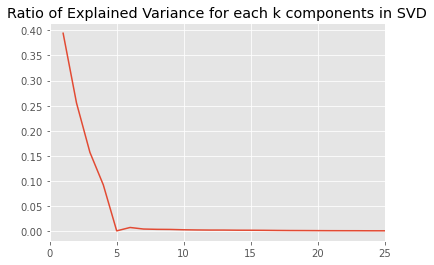

In [149]:
plt.plot(tsvd_range, tsvd_var_ratios)
plt.xlim(0,25)
plt.title('Ratio of Explained Variance for each k components in SVD')
plt.show()

This should tell us that the ideal number of SVD components based on explained variance is 5.

In [150]:
for i in range(0,6):
    svd_col = 'svd_' + str(i+1)
    vector_df[svd_col] = svd_matrix[:, i]

#### Validation that the SVD features are added to the vector dataframe

In [151]:
vector_df.head()

,0,1,2,3,4,5,6,7,8,9,...,gc_content,molecular_weights,aromaticity,instability_index,svd_1,svd_2,svd_3,svd_4,svd_5,svd_6
ids,,,,,,,,,,,,,,,,,,,,,
MT577359,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-1.407284,3.070277,-1.001634,0.196050,4.480078,0.703918,-0.988796,-0.517110,0.389626,-0.051318
MT582456,0.000000,0.000000,0.000000,0.000000,0.014217,0.014222,0.014222,0.014222,0.014105,0.014225,...,-1.404455,2.975379,-0.336182,2.432047,5.023843,-0.101044,0.866132,0.636105,0.179719,0.149957
MT582458,0.014148,0.014151,0.014154,0.014156,0.014136,0.014141,0.014141,0.014141,0.014025,0.014143,...,-1.407284,2.975577,-0.339768,2.437016,5.027367,-0.106666,0.866519,0.638244,0.179835,0.150560
MT582459,0.014148,0.014151,0.014154,0.014156,0.014136,0.014141,0.014141,0.014141,0.014025,0.014143,...,-1.407284,2.975703,-0.334794,2.437016,5.026662,-0.104258,0.870509,0.636687,0.179816,0.150608
MT582460,0.014148,0.014151,0.014154,0.014156,0.014136,0.014141,0.014141,0.014141,0.014025,0.014143,...,-1.407284,2.975577,-0.339768,2.437016,5.027367,-0.106666,0.866519,0.638244,0.179835,0.150560


### Clustering using Kmeans

We can also use an algorithm like Kmeans to see if there is potential for clustering the viruses based on the engineered features from protein vectors and protein analysis metrics.

In [152]:
ssd = []

for i in range(1, 40):
    print(f'Building kmeans with {i+1} clusters')
    kmeans = KMeans(n_clusters=i+1)
    kmeans.fit(svd_matrix)
    print(f'Current sum of squared distance: {kmeans.inertia_:.2}')
    ssd.append(kmeans.inertia_)
    print('-'*100)

Building kmeans with 2 clusters
Current sum of squared distance: 1.5e+05
----------------------------------------------------------------------------------------------------
Building kmeans with 3 clusters
Current sum of squared distance: 1.1e+05
----------------------------------------------------------------------------------------------------
Building kmeans with 4 clusters
Current sum of squared distance: 9.4e+04
----------------------------------------------------------------------------------------------------
Building kmeans with 5 clusters
Current sum of squared distance: 7.9e+04
----------------------------------------------------------------------------------------------------
Building kmeans with 6 clusters
Current sum of squared distance: 6.9e+04
----------------------------------------------------------------------------------------------------
Building kmeans with 7 clusters
Current sum of squared distance: 6e+04
-----------------------------------------------------------

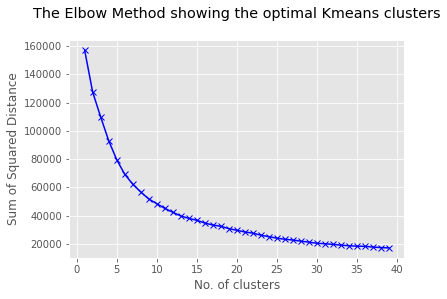

In [114]:
#Plotting to find the number of clusters
plt.plot(range(1,40), ssd,'bx-')
plt.xlabel("No. of clusters")
plt.ylabel("Sum of Squared Distance") #sum of squares within clusters
plt.title("The Elbow Method showing the optimal Kmeans clusters\n")
plt.show()

Using the elbow method for KMeans inertia (sum of squared distance between instances) we can see that even though there is a distinguishable change in slope between K = 10 and K = 20, the sum of squared distance is still at a very high scale.  Usually the SSD would be significantly lower.  At this xcale, the required number of clusters to reduce the SSD to a reasonable level means we would need maybe hundreds of clusters.  Therefore this method won't yield good results.

In [169]:
kmeans = KMeans(n_clusters=20)
kmeans.fit(vector_df.drop(['class','species','family','country'], axis=1))

KMeans(n_clusters=20)

In [170]:
vector_df['cluster'] = kmeans.predict(vector_df.drop(['class','species','family','country'], axis=1))

In [161]:
k_max = 40
k_range = range(1, k_max+1)

# Cluster data into k=1..k_max clusters.
ests = [KMeans(n_clusters=k).fit(svd_matrix) for k in k_range]

In [162]:
from scipy.spatial.distance import cdist, pdist

In [163]:
def get_dists(X, centroids):
    """Calculate distance of each instance from nearest centroid."""
    dists = [cdist(X, center, 'euclidean') for center in centroids]
    dist = [np.min(dist, axis=1) for dist in dists]
    c_idx = [np.argmin(dist, axis=1) for dist in dists]
    
    return dist, c_idx


def get_metrics(X, dist):
    """Cluster "goodness" metrics."""
    total_within_ss = [sum(d**2) for d in dist]  # total within-cluster sum of squares
    total_ss = sum(pdist(X)**2) / X.shape[0]     # total sum of squares
    between_ss = total_ss - total_within_ss      # between-cluster sum of squares
    
    return total_ss, between_ss


def plot_elbow(k_range, total_ss, between_ss, n_true=None):
    """Plot elbow curve."""
    fig = plt.figure(figsize=(10, 8))

    var_exps = (between_ss / total_ss) * 100

    ax = fig.add_subplot(111)
    ax.plot(k_range, var_exps, 'b*-')

    if n_true is not None:
        # Add marker for ground truth.
        kwargs = {'marker': 'o', 'markersize': 12, 'markeredgewidth': 2,
                  'markeredgecolor': 'r', 'markerfacecolor': 'None'}
        k_true = k_range[n_true-1]
        k_true_var_exp = (between_ss[n_true-1] / total_ss) * 100
        ax.plot(k_true, k_true_var_exp, **kwargs)

    ax.set_xlim((0, k_range[-1]))
    ax.set_ylim((0, 100))
    ax.set_xticks(k_range)

    plt.grid(True)
    plt.xlabel("Number of Clusters")
    plt.ylabel("Variance Explained (%)")
    plt.title("k-Means Clustering Elbow Plot")

    plt.show()

In [164]:
centroids = [est.cluster_centers_ for est in ests]

In [165]:
dist, c_idx = get_dists(svd_matrix, centroids)
total_ss, between_ss = get_metrics(svd_matrix, dist)

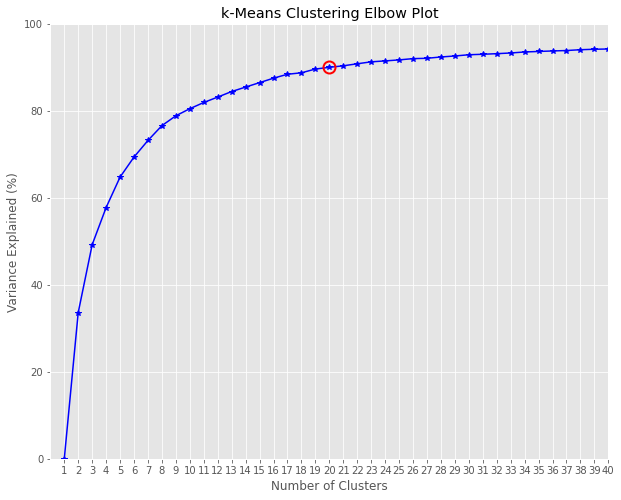

In [166]:
plot_elbow(k_range, total_ss, between_ss, n_true=20)

#### Scatterplot of truncated SVD components with cluster, class and species, etc.

In [171]:
import plotly.express as px
fig = px.scatter_3d(vector_df.reset_index(), x="svd_1", y="svd_2", z='svd_3', color="class", opacity=.25,
                 hover_data=['class', 'ids', 'species', 'family', 'country', 'cluster'], color_continuous_scale=px.colors.sequential.Viridis)
fig.show()

In [173]:
import plotly.express as px
fig = px.scatter_3d(vector_df.reset_index(), x="svd_1", y="svd_2", z='svd_3', color="cluster", opacity=.25,
                 hover_data=['class', 'ids', 'species', 'family', 'country', 'cluster'], color_continuous_scale=px.colors.sequential.Viridis)
fig.show()

Surprisingly with 20 custers, the virus sequences are separated pretty well.  For exampe, Middle East Respiratory Syndrome and Severe Accute Respiratory Syndrom are near eachother, but labeled with two different clusters.  So even in a small dimensional area, the clustering is pretty good.

### Attempt at Dendrogram for Species

In [376]:
def plot_dendrogram(model, **kwargs):
    children = model.children_
    dist = np.arange(children.shape[0])+1
    n_obs = np.arange(2, children.shape[0]+2)
    linkage_matrix = np.column_stack([children, dist, n_obs])
    dendrogram(linkage_matrix.astype(float), **kwargs)

In [382]:
n_family = vector_df['family'].nunique()
n_family

30

In [389]:
X_vect = vector_df[['seq_len', 'gc_content', 'molecular_weights', 'aromaticity', 'instability_index','cluster','class']].copy()
classes = X_vect.pop('class')

In [390]:
# model = AgglomerativeClustering(n_clusters=n_family)
# model = model.fit(X_vect)

In [ ]:
# figure = plt.figure(figsize=(12, 20))
# labels = vector_df['species'].values
# plt.title('Hierarchical Clustering Dendrogram of Virus RNA')
# plot_dendrogram(model, labels=labels, orientation='right', leaf_font_size=9)
# plt.savefig('species_svd_dendrogram.png')
# plt.show()

We were unsuccessful at creating a dendrogram with the full dataset or even a scaled down one using a selection of the SVD components generated from the protein vectors with the protein analysis metrics.  The agglomerative clustering fitting and dendrogram plotting process takes too long, so we've had to cancel the process many times.

### Cluster map from Kmeans cluster and protein analysis features

c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\seaborn\matrix.py:649: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



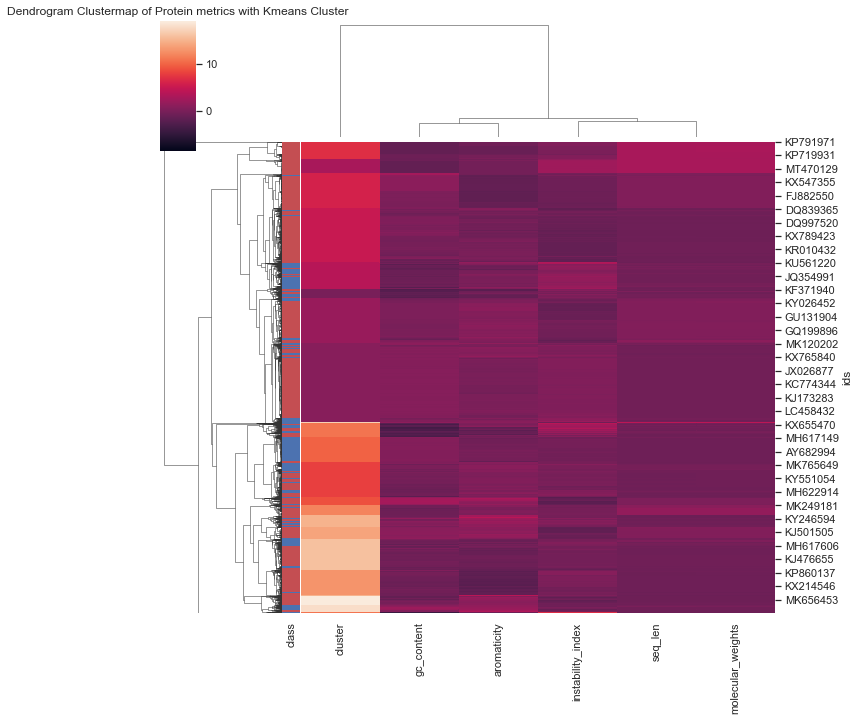

In [391]:
sns.set(color_codes=True)
lut = dict(zip(classes.unique(), "rbg"))
row_colors = classes.map(lut)
g = sns.clustermap(X_vect, row_colors=row_colors)
plt.title('Dendrogram Clustermap of Protein metrics with Kmeans Cluster')
plt.show()

## Training Predictive Models

#### Use simple OLS linear regression and LogisticRegression as baseline performance

In [174]:
import statsmodels.api as sm
import statsmodels.formula.api as smf

In [195]:
vec_cols = list(np.arange(5000))
vec_cols_str = [str(col) for col in vec_cols]
vec_col_str = ' + '.join(vec_cols_str)

In [196]:
svd_cols = ['svd_' + str(i+1) for i in np.arange(6)]

In [197]:
svd_cols

['svd_1', 'svd_2', 'svd_3', 'svd_4', 'svd_5', 'svd_6']

In [178]:
target_col = 'class'

In [200]:
x = np.matrix(vector_df[vec_cols].values)
y = np.array(vector_df[target_col].values).reshape(-1, 1)

In [201]:
x.shape

(43995, 5000)

In [202]:
y.shape

(43995, 1)

In [203]:
y_bin = []
for i in range(len(y)):
    if y[i] == 'virulent':
        y_bin.append(1)
    else:
        y_bin.append(0)

In [204]:
model = sm.OLS(y_bin, x).fit()
print(model.summary())

                                 OLS Regression Results                                
Dep. Variable:                      y   R-squared (uncentered):                   0.542
Model:                            OLS   Adj. R-squared (uncentered):              0.537
Method:                 Least Squares   F-statistic:                              101.5
Date:                Sat, 25 Jul 2020   Prob (F-statistic):                        0.00
Time:                        00:51:38   Log-Likelihood:                         -38846.
No. Observations:               43995   AIC:                                  7.871e+04
Df Residuals:                   43488   BIC:                                  8.311e+04
Df Model:                         507                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

In [209]:
model.params

array([ 0.03778944, -0.02871878, -0.43763879, ...,  0.0081097 ,
        0.0081097 , -0.00763268])

In [213]:
pval_df = pd.DataFrame({'vector': vec_cols, 'pval': model.pvalues, 'coef': model.params})
pval_df['proteins'] = vectorizer.get_feature_names()
# pval_df[pval_df['pval'] <= .05].to_csv('protein_importance.csv', index=False)
pval_df.to_csv('protein_importance_unfiltered.csv', index=False)
pval_list = pval_df[pval_df['pval'] <= .05]['vector'].tolist()

#### Index Positions of 25 out of 102 most relevant/important proteins

In [270]:
pval_list[0:25]

[8,
 94,
 313,
 364,
 451,
 559,
 569,
 615,
 681,
 778,
 817,
 838,
 910,
 935,
 1078,
 1137,
 1168,
 1198,
 1220,
 1246,
 1303,
 1390,
 1453,
 1504,
 1514]

Based on the OLS model, there are 102 protein vectors which have a statistically significant relationship with the predictive outcome for virulent class.  However, OLS isn't optimized for a binary nor multiclass classification problem.  However, this might still provide useful insight into the feature importance for training models more appropriate for classification.  Most of the relevant protein vectors are very short, only 2-3 protein characters long, however some are longer.  For example:

EAVGINWSVHQHHATFSPLPNHLMFMSYCSSLQAVPWVALGHGH

This is a protein associated with Hepatits B virus!

In [214]:
model_df = analysis_df.copy()

In [215]:
model_df.to_csv('model_data.csv')

### Save point #3

In [ ]:
model_df = pd.read_csv('model_data.csv')

In [219]:
vec_cols = list(np.arange(0,5000)) # vec_cols + 
cols_to_drop = ['seq_id','seq_name','seq_desc','nucleotide_sequence','protein_sequence','class','Country','Genus','Species','Family','Length','Nuc_Completeness','Geo_Location','Host','Collection_Date','Release_Date','amino_acid_percents']

In [220]:
model_df['class'] = model_df['class'] == 'virulent'

In [221]:
model_df['class'].value_counts()

True     32881
False    11114
Name: class, dtype: int64

In [222]:
model_df.head()

,seq_id,seq_name,seq_desc,nucleotide_sequence,class,seq_len,protein_sequence,gc_content,amino_acid_percents,molecular_weights,...,amino_acid_N,amino_acid_P,amino_acid_Q,amino_acid_R,amino_acid_S,amino_acid_T,amino_acid_V,amino_acid_W,amino_acid_Y,Country
0,MT577359,MT577359.1,MT577359.1 |Severe acute respiratory syndrome ...,CAACCAACTTTCGATCTCTTGTAGATCTGTTCTCTAAACGAACTTT...,True,29816,QPTFDLL ICSLNEL NLCGCHSAACLVHSRSIINN LLSLTGHE ...,38.006,"{'A': 0.0552571782689527, 'C': 0.0309853336087...",1.091393e+06,...,0.052262,0.034497,0.042243,0.035736,0.072712,0.074055,0.078806,0.010122,0.040797,Bangladesh
1,MT582456,MT582456.1,MT582456.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,True,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.020,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065028e+06,...,0.051436,0.031561,0.035274,0.060500,0.088239,0.074042,0.059845,0.028721,0.055040,Germany
2,MT582458,MT582458.1,MT582458.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,True,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.006,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065083e+06,...,0.051436,0.031561,0.035164,0.060500,0.088239,0.073933,0.059845,0.028721,0.055040,Germany
3,MT582459,MT582459.1,MT582459.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,True,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.006,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065118e+06,...,0.051436,0.031561,0.035274,0.060500,0.088239,0.074042,0.059845,0.028721,0.055040,Germany
4,MT582460,MT582460.1,MT582460.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,True,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.006,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065083e+06,...,0.051436,0.031561,0.035164,0.060500,0.088239,0.073933,0.059845,0.028721,0.055040,Germany


In [223]:
model_df.drop(cols_to_drop, axis=1).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43995 entries, 0 to 43994
Data columns (total 25 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   seq_len            43995 non-null  int64  
 1   gc_content         43995 non-null  float64
 2   molecular_weights  43995 non-null  float64
 3   aromaticity        43995 non-null  float64
 4   instability_index  43995 non-null  float64
 5   amino_acid_A       43995 non-null  float64
 6   amino_acid_C       43995 non-null  float64
 7   amino_acid_D       43995 non-null  float64
 8   amino_acid_E       43995 non-null  float64
 9   amino_acid_F       43995 non-null  float64
 10  amino_acid_G       43995 non-null  float64
 11  amino_acid_H       43995 non-null  float64
 12  amino_acid_I       43995 non-null  float64
 13  amino_acid_K       43995 non-null  float64
 14  amino_acid_L       43995 non-null  float64
 15  amino_acid_M       43995 non-null  float64
 16  amino_acid_N       439

In [225]:
cols_to_drop_w_class = [col for col in cols_to_drop if col != 'class']

#### Correlation heatmap of model features

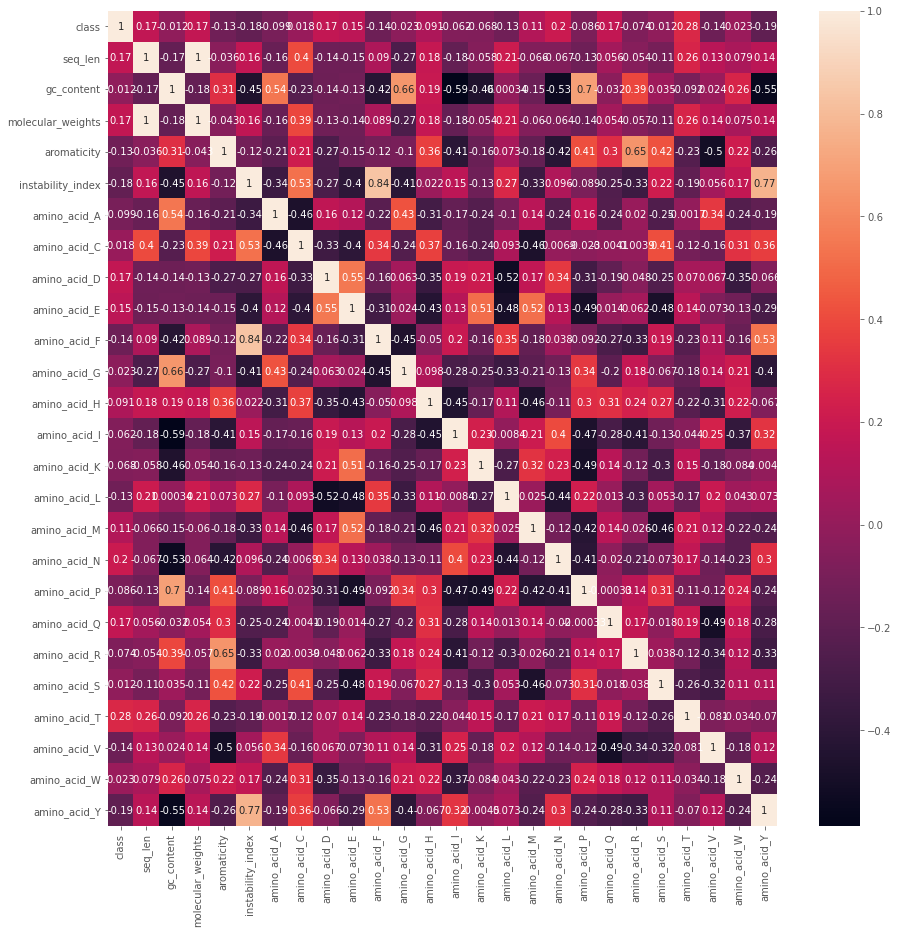

In [226]:
model_corr = model_df.drop(cols_to_drop_w_class, axis=1).corr()
plt.figure(figsize=(15,15))
sns.heatmap(model_corr, annot=True);

### Splitting dataframe of features for predictive model by random 70/30

In [227]:
X_train, X_test, y_train, y_test = train_test_split(model_df.drop(cols_to_drop, axis=1), model_df['class'], test_size=0.3, random_state=42)

In [228]:
y_test.value_counts()

True     9869
False    3330
Name: class, dtype: int64

### Building a Guassian Naive Bayes Classifier

In [310]:
gnb = GaussianNB()
gnb.fit(X_train, y_train)
y_pred_nb = gnb.predict(X_test)

In [311]:
y_train.head()

27971     True
24166     True
22718     True
38864    False
17947     True
Name: class, dtype: bool

#### Confusion Matrix

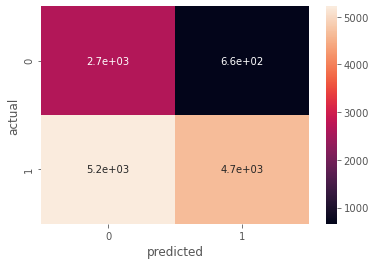

In [312]:
sns.heatmap(confusion_matrix(y_test, y_pred_nb, labels=[False, True]), annot=True)
plt.xlabel('predicted')
plt.ylabel('actual')
plt.show()

Unlike the Extra Trees classifier, the Naive Bayes model creates over 5,000 false negatives and over 600 false positives.

#### Accuracy Score

In [313]:
gnb.score(X_test, y_test)

0.5547389953784377

#### Classification Report

In [314]:
print(classification_report(y_test, y_pred_nb, labels=[False, True]))

              precision    recall  f1-score   support

       False       0.34      0.80      0.48      3330
        True       0.88      0.47      0.61      9869

    accuracy                           0.55     13199
   macro avg       0.61      0.64      0.54     13199
weighted avg       0.74      0.55      0.58     13199



### Building a Logistic Regression Classifier

In [323]:
lrc = LogisticRegression()
lrc.fit(X_train, y_train)
y_pred_lr = lrc.predict(X_test)

#### Accuracy Score

In [324]:
lrc.score(X_test, y_test)

0.7372528221834987

#### Confusion Matrix

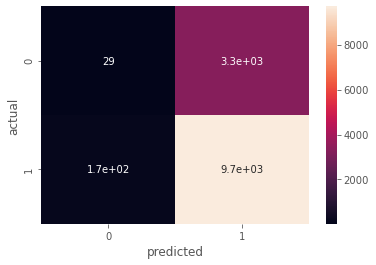

In [325]:
sns.heatmap(confusion_matrix(y_test, y_pred_lr), annot=True)
plt.xlabel('predicted')
plt.ylabel('actual')
plt.show()

#### Classification Report

In [326]:
print(classification_report(y_test, y_pred_lr, labels=[False, True]))

              precision    recall  f1-score   support

       False       0.15      0.01      0.02      3330
        True       0.75      0.98      0.85      9869

    accuracy                           0.74     13199
   macro avg       0.45      0.50      0.43     13199
weighted avg       0.60      0.74      0.64     13199



### Selection Relevant Features for Logistic Regression

Since the logistic regression model performed well, but not the best (significantly better than NB), we wanted to try using a feature selection model to narrow the feature set to optimize the logistic regression model accuracy.

In [327]:
selector = RFE(lrc, n_features_to_select=1)
selector = selector.fit(X_train, y_train)

c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\sklearn\linear_model\_logistic.py:764: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [328]:
selector.ranking_

array([23, 22, 24, 21,  8,  7, 25, 10,  6, 20, 19,  4, 13,  5, 16, 14,  3,
       12, 15,  9, 18,  1, 11, 17,  2])

In [329]:
lrc.coef_

array([[-6.07456226e-04,  4.87535731e-02,  1.89795073e-05,
        -3.32501956e-02, -2.17974127e-04, -5.12043994e-05,
         1.37620983e-05,  2.22678959e-04,  3.14038334e-04,
        -1.02099271e-04,  1.04233321e-04,  9.42245967e-05,
         5.51632119e-05, -2.30124638e-05, -2.43559062e-04,
         1.29520983e-04,  3.34843953e-04, -5.53140321e-05,
         2.20526282e-04, -7.10652323e-05,  1.58121929e-04,
         3.38874193e-04, -1.28820570e-04,  2.86526535e-05,
        -1.44527510e-04]])

In [342]:
Xy = pd.concat([X_train, y_train], axis=1)

In [343]:
Xy['class_label'] = Xy['class'].apply(lambda x: 'virulent' if x else 'non-virulent')

#### Correlation heatmap of train data

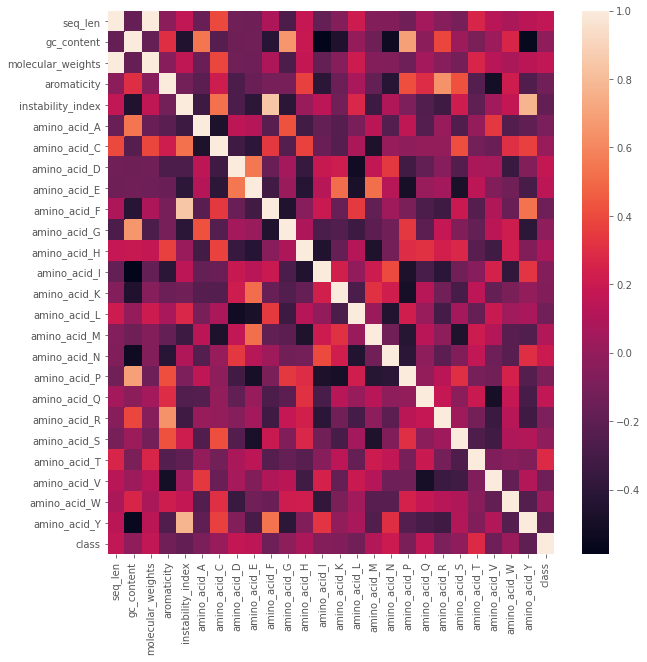

In [344]:
Xy_corr = Xy.corr()
plt.figure(figsize=(10,10))
sns.heatmap(Xy_corr);

As we can see from the correlation heatmap of just the training data, only a few features have a higher correlation coefficient with the target variable 'class'.

#### Creating a mask of features to keep based on logistic regression classifier coefficient

In [345]:
mask = np.round(lrc.coef_, decimals=2)>0

In [346]:
cols_to_keep = []

In [347]:
for ii, val in enumerate(mask[0]):
    print(ii, val)
    if val == True:
        cols_to_keep.append(X_train.columns.tolist()[ii])

0 False
1 True
2 False
3 False
4 False
5 False
6 False
7 False
8 False
9 False
10 False
11 False
12 False
13 False
14 False
15 False
16 False
17 False
18 False
19 False
20 False
21 False
22 False
23 False
24 False


In [348]:
cols_to_keep

['gc_content']

In [259]:
X_train[cols_to_keep].head()

,gc_content
27971,46.375
24166,51.856
22718,42.304
38864,48.387
17947,45.485


#### Trying to split the data on features kept from logistic regression coefficient values > 0

In [359]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(model_df[cols_to_keep], model_df['class'], test_size=0.3, random_state=42)

In [360]:
lrc2 = LogisticRegression()
lrc2.fit(X_train2, y_train2)
y_pred_lr2 = lrc2.predict(X_test2)

#### Confusion Matrix

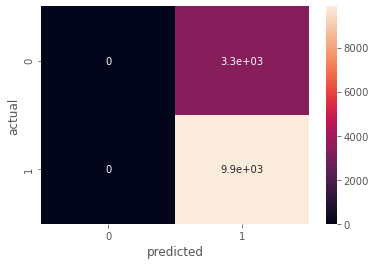

In [361]:
sns.heatmap(confusion_matrix(y_test2, y_pred_lr2), annot=True)
plt.xlabel('predicted')
plt.ylabel('actual')
plt.show()

#### Accuracy Score

In [362]:
lrc2.score(X_test2, y_test2)

0.7477081597090689

#### Classification Report

In [363]:
print(classification_report(y_test2, y_pred_lr2))

              precision    recall  f1-score   support

       False       0.00      0.00      0.00      3330
        True       0.75      1.00      0.86      9869

    accuracy                           0.75     13199
   macro avg       0.37      0.50      0.43     13199
weighted avg       0.56      0.75      0.64     13199



c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\sklearn\metrics\_classification.py:1221: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



It appears from the above that filtering the feature set based on coefficient > 0 didn't help improve the performance of the logistic regression model at all.

### Building an Extra Trees Ensemble Classifier

As we will see below, the extra trees classifier easily out performs the other vanilla classifiers without any kin dof hyperparameter tuning of the models.  This ensemble achieves near 100% accuracy, and very minimal Type I or Type II errors.  However, we are both skeptic that this is overfitting on multicolliearity of sequence length and molecular weight, as well as potential bias or limitations in the dataset downloaded from the NCBI Virus database.

In [290]:
etc = ExtraTreesClassifier()
etc.fit(X_train, y_train)
y_pred = etc.predict(X_test)

#### Confusion Matrix

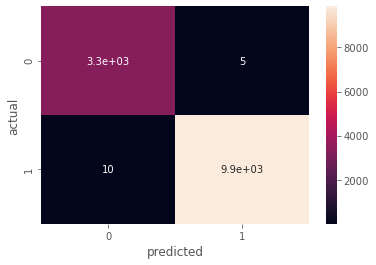

In [291]:
sns.heatmap(confusion_matrix(y_test, y_pred), annot=True)
plt.xlabel('predicted')
plt.ylabel('actual')
plt.show()

Here we can see there are only 8 false positives and 12 false negatives.  Very highly performant model!

#### Near 100% accuracy score

In [292]:
etc.score(X_test, y_test)

0.9988635502689598

#### Classification Report

In [293]:
print(classification_report(y_test, y_pred, labels=[False, True]))

              precision    recall  f1-score   support

       False       1.00      1.00      1.00      3330
        True       1.00      1.00      1.00      9869

    accuracy                           1.00     13199
   macro avg       1.00      1.00      1.00     13199
weighted avg       1.00      1.00      1.00     13199



#### Estimating what the most important features are

In [294]:
est = etc.estimators_
importance = etc.feature_importances_
importance

array([0.11412248, 0.03212622, 0.09976227, 0.01816926, 0.0323156 ,
       0.02698031, 0.03877612, 0.02799201, 0.06646732, 0.03011855,
       0.04577857, 0.03557516, 0.02135054, 0.03019028, 0.03387888,
       0.03922064, 0.04063299, 0.05151491, 0.04415936, 0.02245729,
       0.02356549, 0.03721289, 0.02637666, 0.02394299, 0.0373132 ])

In [295]:
X_train.columns

Index(['seq_len', 'gc_content', 'molecular_weights', 'aromaticity',
       'instability_index', 'amino_acid_A', 'amino_acid_C', 'amino_acid_D',
       'amino_acid_E', 'amino_acid_F', 'amino_acid_G', 'amino_acid_H',
       'amino_acid_I', 'amino_acid_K', 'amino_acid_L', 'amino_acid_M',
       'amino_acid_N', 'amino_acid_P', 'amino_acid_Q', 'amino_acid_R',
       'amino_acid_S', 'amino_acid_T', 'amino_acid_V', 'amino_acid_W',
       'amino_acid_Y'],
      dtype='object')

In [296]:
indices = np.argsort(importance)[::-1]

In [297]:
for f in range(X_train.shape[1]):
    print("%d. feature %d (%f)" % (f + 1, indices[f], importance[indices[f]]))

1. feature 0 (0.114122)
2. feature 2 (0.099762)
3. feature 8 (0.066467)
4. feature 17 (0.051515)
5. feature 10 (0.045779)
6. feature 18 (0.044159)
7. feature 16 (0.040633)
8. feature 15 (0.039221)
9. feature 6 (0.038776)
10. feature 24 (0.037313)
11. feature 21 (0.037213)
12. feature 11 (0.035575)
13. feature 14 (0.033879)
14. feature 4 (0.032316)
15. feature 1 (0.032126)
16. feature 13 (0.030190)
17. feature 9 (0.030119)
18. feature 7 (0.027992)
19. feature 5 (0.026980)
20. feature 22 (0.026377)
21. feature 23 (0.023943)
22. feature 20 (0.023565)
23. feature 19 (0.022457)
24. feature 12 (0.021351)
25. feature 3 (0.018169)


In [304]:
length = X_test['seq_len']
weights = X_test['molecular_weights']
gc = X_test['gc_content']
eaa = X_test['amino_acid_E']
paa = X_test['amino_acid_P']
actual = y_test.values
predicted = y_pred

In [305]:
model_out = pd.DataFrame({
    'length': length,
    'weight': weights,
    'gc_content': gc,
    'amino_acid_e': eaa,
    'amino_acid_p': paa,
    'actual': actual,
    'predicted': predicted
    })

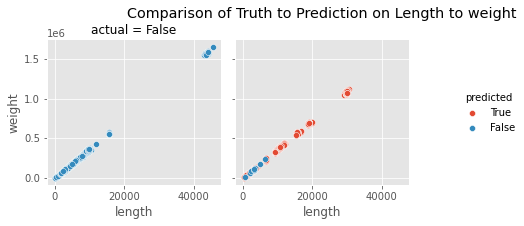

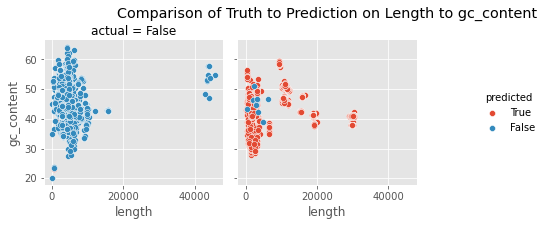

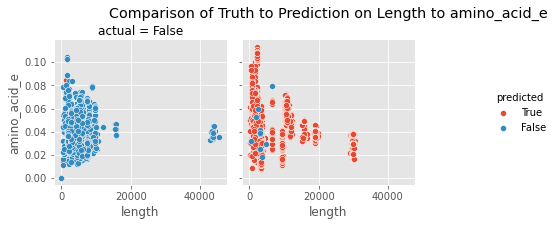

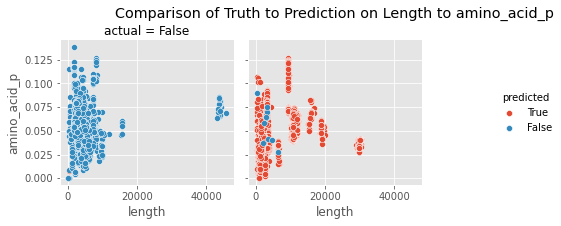

In [308]:
for col in ['weight','gc_content','amino_acid_e','amino_acid_p']:
    g = sns.FacetGrid(model_out, col='actual',  hue="predicted", hue_order=[True, False])
    g = (g.map(plt.scatter, 'length', col, edgecolor="w")
          .add_legend())
    plt.title(f'Comparison of Truth to Prediction on Length to {col}\n')

In [303]:
fig = px.scatter_3d(model_out, x="weight", y="amino_acid_e", z="gc_content", color="predicted", opacity=.25,
                 hover_data=['length','weight','gc_content','amino_acid_e','actual','predicted'], color_continuous_scale=px.colors.sequential.Viridis)
fig.show()

### Evaluate Model Performance with AUROC

In [373]:
def plot_roc(X, y, models, model_names):
    plt.figure(0, figsize = [8, 7]).clf()
    plt.plot([0, 1], [0, 1], 'r--')
    plt.xlim([-.01, 1.01])
    plt.ylim([-.01, 1.01])
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    
    for ii, model in enumerate(models):
        y_prob = model.predict_proba(X)[:, 1]
        fpr, tpr, threshold = roc_curve(y, y_prob)
        roc_auc = auc(fpr, tpr)

        plt.plot(fpr, tpr, label = "{} AUC = {:0.2f}".format(model_names[ii], roc_auc))

    plt.legend(loc = 'lower right');

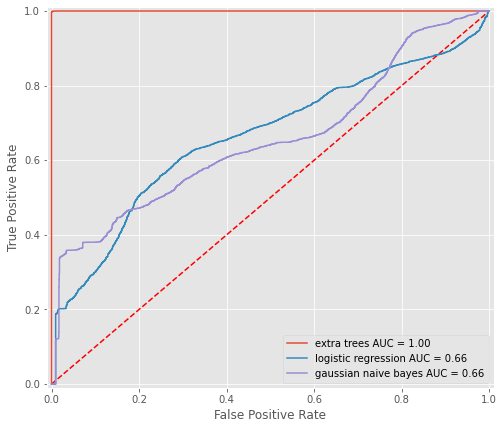

In [374]:
plot_roc(X_test, y_test, [etc, lrc, gnb], ['extra trees', 'logistic regression','gaussian naive bayes'])

In conclusion, we achieved some interesting results with clustering tools, but ultimately some of the simplest features obtained from the raw data and protein analysis yielded the best predictive results if a virus is virulent or not.  Clearly the ensemble Extra Trees model worked the best of the three models attempted here.  Perhaps others would have performed just as well or in between the gap but achieving near 100% accuracy and minimal Type I and Type II errors tells us that the Extra Trees ensemble is ready for deployment.